
    The objective of this notebook is to propose an analytical view of e-commerce relationship in Brazil. For this we will  first go through an exploratory data analysis using graphical tools to create self explanatory plots for better understanding what is behind brazilian online purchasing. Finally we will look at customers reviews and implement Sentiment Analysis to make a text classification using Natural Language Process tools.

    We will go through a extensive journey for understanding the data and plotting some useful charts to clarify the concepts and get insights from data and, at the end, we will go through a step-by-step code on text preparating and sentiment classification using the reviews left from customer on online platforms.

In [348]:
%reload_ext autoreload
%autoreload 1
%aimport viz_utils

### 1. Libraries

In [349]:
# Standard libs
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
from matplotlib.gridspec import GridSpec
pd.set_option('display.max_columns', 100)
import plotly.offline as py
import plotly.express as px
import plotly.graph_objs as go
import json
import requests
import folium
from folium.plugins import FastMarkerCluster, Fullscreen, MiniMap, HeatMap, HeatMapWithTime, LocateControl

# Utilities
from viz_utils import *
from custom_transformers import *
from ml_utils import *

# DataPrep
import re
import nltk
from nltk.corpus import stopwords
from nltk.stem import RSLPStemmer
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import Pipeline
import joblib

# Modeling
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
import lightgbm as lgb

# . Reading the Data

<span class="girk">For this task we have difference data sources, each one describing a specific topic related to e-commerce sales</span>. The files are:

            - olist_customers_dataset.csv
            - olist_geolocation_dataset.csv
            - olist_orders_dataset.csv
            - olist_order_items_dataset.csv
            - olist_order_payments_dataset.csv
            - olist_order_reviews_dataset.csv
            - olist_products_dataset.csv
            - olist_sellers_dataset.csv
            - product_category_name_translation.csv
    
    The relationship between these files are described on the documentation. So lets read the datasets and make an initial analysis with all of them. This step will help us a lot to take right decisions in a future exploratory data analysis.

In [350]:
#Reading all the files 

olist_customer = pd.read_csv('olist_order_customer_dataset.csv')
olist_geolocation = pd.read_csv('olist_geolocation_dataset.csv')
olist_orders = pd.read_csv('olist_orders_dataset.csv')
olist_order_items = pd.read_csv('olist_order_items_dataset.csv')
olist_order_payments = pd.read_csv('olist_order_payments_dataset.csv')
olist_order_reviews = pd.read_csv('olist_order_reviews_dataset.csv')
olist_products = pd.read_csv('olist_products_dataset.csv')
olist_sellers = pd.read_csv('olist_sellers_dataset.csv')
olist_product_ename = pd.read_csv('product_category_name_translation.csv')

## 2.1 An Overview from the Data

In [351]:
#Collections for each dataset

datasets = [olist_customer, olist_geolocation, 
            olist_orders, olist_order_items,
            olist_order_payments, olist_order_reviews,
            olist_products, olist_sellers, olist_product_ename]

names = ['olist_customer', 'olist_geolocation', 
            'olist_orders', 'olist_order_items',
            'olist_order_payments', 'olist_order_reviews',
            'olist_products', 'olist_sellers', 'olist_product_ename']

In [352]:
# Creating a DataFrame with useful information about all datasets 

data_info = pd.DataFrame({})
data_info['dataset'] = names
data_info['n_rows'] = [df.shape[0] for df in datasets]
data_info['n_cols'] = [df.shape[1] for df in datasets]
data_info['null_amount'] = [df.isnull().sum().sum() for df in datasets]
data_info['qty_null_columns'] = [len([col for col, null in df.isnull().sum().items() if null >0]) for df in datasets]

In [353]:
data_info.style.background_gradient()

,dataset,n_rows,n_cols,null_amount,qty_null_columns
0,olist_customer,99441,5,0,0
1,olist_geolocation,1000163,5,0,0
2,olist_orders,99441,8,4908,3
3,olist_order_items,112650,7,0,0
4,olist_order_payments,103886,5,0,0
5,olist_order_reviews,100000,7,146532,2
6,olist_products,32951,9,2448,8
7,olist_sellers,3095,4,0,0
8,olist_product_ename,71,2,0,0


Now lets use a homemade function found on the module viz_utils.py for looking at each dataset and bring soem detailed parameters about the content. With this function we can get the following information for each dataset column:

                - Column name
                - Null amount
                - Null percentage among the respective dataset
                - Data type
                - Total categorical entries

# . Exploratory Data Analysis 

## Total Orders on E-Commerce

- We know that e-commerce is really a growing trend in global persepctive. Lets dive into the orders dataset to see how this trend can be presented in Brazil, at least on the dataset range

Looking at the dataset columns, we can see orders with different status and with different timestamp columns like purchase, approved, delivered and estimated delivery. First, lets look at the status of the orders we have in this dataset.

- How many orders we have for each status?

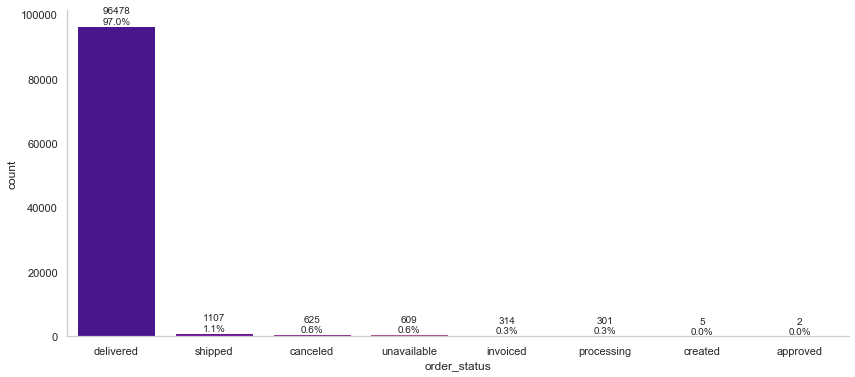

In [354]:
df_orders = olist_orders.merge(olist_customer, how='left', on='customer_id')
fig, ax = plt.subplots(figsize=(14, 6))
single_countplot(df_orders, x='order_status', ax=ax)
plt.show()

- Is that a growing trend on e-commerce in Brazil? How can we describe a complete scenario?

    For the next plots, lets dive into the real evolution of e-commerce in terms of purchase orders. For this, we have to extract some info on the order_purchase_timestamp following the topics:

1. Transform timestamp columns
2. Extract time attributes from these datetime columns (year, month, day, day of week and hour)
3. Evaluate the e-commerce scenario using this attributes.

In [355]:
# Changing the data type for date  columns
timestamp_cols = ['order_purchase_timestamp', 'order_approved_at', 'order_delivered_carrier_date', 'order_estimated_delivery_date']

for col in timestamp_cols:
    df_orders[col] = pd.to_datetime(df_orders[col])
    
# Extracting attributes for purchase date - Year and Month 

df_orders['order_purchase_year'] = df_orders['order_purchase_timestamp'].apply(lambda x: x.year)
df_orders['order_purchase_month'] = df_orders['order_purchase_timestamp'].apply(lambda x: x.month)
df_orders['order_purchase_month_name'] = df_orders['order_purchase_timestamp'].apply(lambda x: x.strftime('%b'))
df_orders['order_purchase_year_month'] = df_orders['order_purchase_timestamp'].apply(lambda x: x.strftime('%Y%m'))
df_orders['order_purchase_date'] = df_orders['order_purchase_timestamp'].apply(lambda x: x.strftime('%Y%m%d'))

# Extracting attributes for purchase date - Day and Day of Week
df_orders['order_purchase_day'] = df_orders['order_purchase_timestamp'].apply(lambda x: x.day)
df_orders['order_purchase_dayofweek'] = df_orders['order_purchase_timestamp'].apply(lambda x: x.dayofweek)
df_orders['order_purchase_dayofweek_name'] = df_orders['order_purchase_timestamp'].apply(lambda x: x.strftime('%a'))

In [356]:
df_orders.head(3)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_purchase_year,order_purchase_month,order_purchase_month_name,order_purchase_year_month,order_purchase_date,order_purchase_day,order_purchase_dayofweek,order_purchase_dayofweek_name
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,2017,10,Oct,201710,20171002,2,0,Mon
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13,af07308b275d755c9edb36a90c618231,47813,barreiras,BA,2018,7,Jul,201807,20180724,24,1,Tue
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04,3a653a41f6f9fc3d2a113cf8398680e8,75265,vianopolis,GO,2018,8,Aug,201808,20180808,8,2,Wed


In [357]:
# Extracting attributes for purchase date - Hour  and Time of the Day

df_orders['order_purchase_hour'] = df_orders['order_purchase_timestamp'].apply(lambda x: x.hour)
hours_bins = [-0.1, 6, 12, 18, 23]
hours_labels = ['Dawn', 'Morning', 'Afternoon', 'Night']
df_orders['order_purchase_time_day'] = pd.cut(df_orders['order_purchase_hour'], hours_bins, labels = hours_labels)

# New DataFrame after transformations

df_orders.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_purchase_year,order_purchase_month,order_purchase_month_name,order_purchase_year_month,order_purchase_date,order_purchase_day,order_purchase_dayofweek,order_purchase_dayofweek_name,order_purchase_hour,order_purchase_time_day
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,2017,10,Oct,201710,20171002,2,0,Mon,10,Morning
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13,af07308b275d755c9edb36a90c618231,47813,barreiras,BA,2018,7,Jul,201807,20180724,24,1,Tue,20,Night
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04,3a653a41f6f9fc3d2a113cf8398680e8,75265,vianopolis,GO,2018,8,Aug,201808,20180808,8,2,Wed,8,Morning
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15,7c142cf63193a1473d2e66489a9ae977,59296,sao goncalo do amarante,RN,2017,11,Nov,201711,20171118,18,5,Sat,19,Night
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26,72632f0f9dd73dfee390c9b22eb56dd6,9195,santo andre,SP,2018,2,Feb,201802,20180213,13,1,Tue,21,Night


     1. Is there any growing trend on brazilian e-commerce?
     2. On what day of week brazilians customers tend to do online purchasing?
     3. What time brazilians customers tend do buy (Dawn, Morning, Afternoon or Night)?

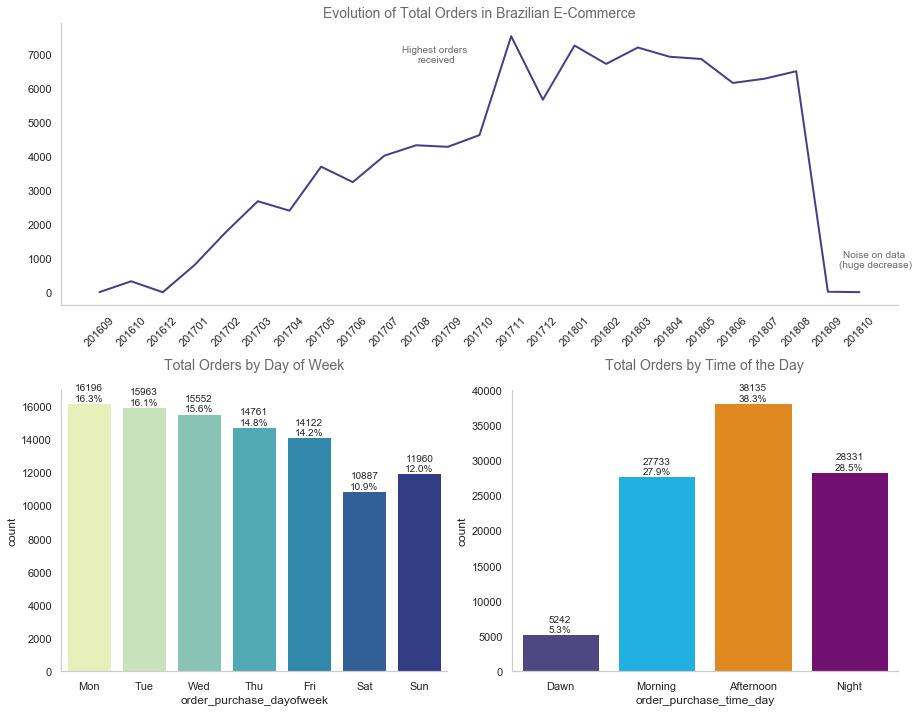

In [358]:
fig = plt.figure(constrained_layout=True, figsize=(13, 10))

# Axis definition
gs = GridSpec(2, 2, figure=fig)
ax1 = fig.add_subplot(gs[0, :])
ax2 = fig.add_subplot(gs[1, 0])
ax3 = fig.add_subplot(gs[1, 1])

# Lineplot - Evolution of e-commerce orders along time 

sns.lineplot(data=df_orders['order_purchase_year_month'].value_counts().sort_index(), ax=ax1, 
             color='darkslateblue', linewidth=2)

ax1.annotate(f'Highest orders \nreceived', xy = (13, 7500), xytext=(-75, -25), 
             textcoords='offset points', bbox=dict(boxstyle="round4", fc="w", pad=.8),
             arrowprops=dict(arrowstyle='-|>', fc='w'), color='dimgrey', ha='center')

ax1.annotate(f'Noise on data \n(huge decrease)', xy = (23, 0), xytext=(48, 25), 
             textcoords='offset points', bbox=dict(boxstyle="round4", fc="w", pad=.5),
             arrowprops=dict(arrowstyle='-|>', fc='w'), color='dimgrey', ha='center')

format_spines(ax1, right_border=False)

for tick in ax1.get_xticklabels():
    tick.set_rotation(45)
ax1.set_title('Evolution of Total Orders in Brazilian E-Commerce', size=14, color='dimgrey')

# Barchart - Total of orders by day of week

single_countplot(df_orders, x = 'order_purchase_dayofweek', ax = ax2, order = False, palette='YlGnBu')

weekday_label = ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun']
ax2.set_xticklabels(weekday_label)
ax2.set_title('Total Orders by Day of Week', size=14, color='dimgrey', pad=20)

# Barchart - Total of orders by time of the day

day_color_list = ['darkslateblue', 'deepskyblue', 'darkorange', 'purple']
single_countplot(df_orders, x='order_purchase_time_day', ax=ax3, order=False, palette = day_color_list)
ax3.set_title('Total Orders by Time of the Day', size=14, color='dimgrey', pad=20)

plt.tight_layout()
plt.show()

By the chart above we can conclude:

- E-commerce on Brazil really has a growing trend along the time. We can see some seasonality with peaks at specific months, but in general we can see clear clear that customers are more prone to buy things online than before.
- Monday are the prefered day for Brazillian's customers and the ytend to buy more at afternoons.

Obs: We have a sharp decrease between Auguest 2018 and September 2018 and maybe the origin of that is related to noise on data. For further comparison between 2017 and 2018, lets just consider orders between January and August in both years


    - E-commerce: a comparison between 2017 and 2018

In [359]:
df_orders.head(1)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_purchase_year,order_purchase_month,order_purchase_month_name,order_purchase_year_month,order_purchase_date,order_purchase_day,order_purchase_dayofweek,order_purchase_dayofweek_name,order_purchase_hour,order_purchase_time_day
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,2017,10,Oct,201710,20171002,2,0,Mon,10,Morning


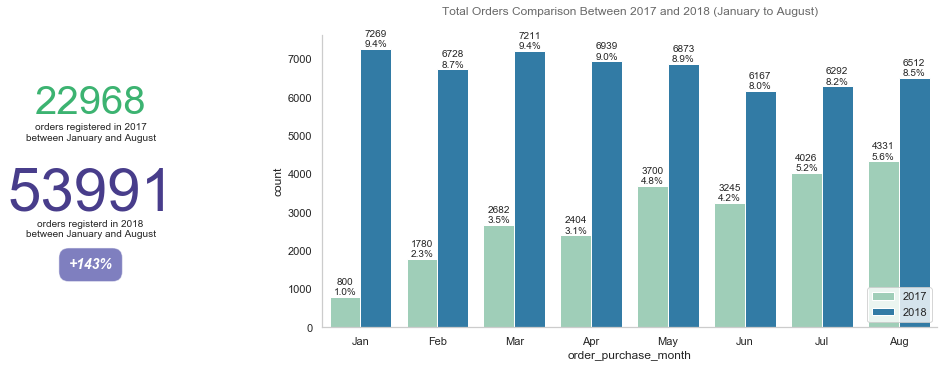

In [360]:
# Creating figure

fig = plt.figure(constrained_layout = True, figsize = (13, 5))

# Axis definition

gs = GridSpec(1, 3, figure = fig)
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1:])

# Annotation - Grown on e-commerce orders between 2017 and 2018

df_orders_compare = df_orders.query('order_purchase_year in (2017, 2018) & order_purchase_month <=8')
year_orders = df_orders_compare['order_purchase_year'].value_counts()
growth = int(round(100 * (1 + year_orders[2017] / year_orders[2018]), 0))

ax1.text(0, 0.73, f'{year_orders[2017]}', fontsize = 40, color = 'mediumseagreen', ha = 'center')
ax1.text(0, 0.64, 'orders registered in 2017\nbetween January and August', fontsize = 10, ha = 'center')
ax1.text(0, 0.4, f'{year_orders[2018]}', fontsize = 60, color = 'darkslateblue', ha = 'center')
ax1.text(0, 0.31, 'orders registerd in 2018\nbetween January and August', fontsize = 10, ha ='center')

signal = '+' if growth > 0 else '-'
ax1.text(0, 0.2, f'{signal}{growth}%', fontsize = 14, ha = 'center', color = 'white', style = 'italic', weight = 'bold', bbox = dict(facecolor = 'navy', alpha = 0.5, pad = 10, boxstyle = 'round, pad =.7'))

ax1.axis('off')

# Bar chart - Comparison between monthly sales between 2017 and 2018

single_countplot(df_orders_compare, x='order_purchase_month', hue = 'order_purchase_year', 
                 ax = ax2, order = False, palette ='YlGnBu')
month_label = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug']
ax2.set_xticklabels(month_label)
ax2.set_title('Total Orders Comparison Between 2017 and 2018 (January to August)', size = 12, color = 'dimgrey', pad = 20)

plt.legend(loc = 'lower right')
plt.show()

##  E-commerce Around Brazil

For preparing the data to a workaround analysis on brazilians states e-commerce, we will take the following steps:

            1. Merge the orders data to order_items data
            2. Use an API (brazilian govermetn) to  return the region of each customer_state
            3. Purpose useful charts to answer business questions

        Brazilian APIs and links for geolocation info:
        
                https://servicodados.ibge.gov.br/api/docs/localidades?versao=1

In [380]:
# Merging orders and order_items

df_orders_items = df_orders.merge(olist_order_items, how = 'left', on ='order_id')

df_orders_items.head(3)

# Using the API to bring the region to the data 

r = requests.get('https://servicodados.ibge.gov.br/api/v1/localidades/mesorregioes')
content = [c['UF'] for c in json.loads(r.text)]

br_info = pd.DataFrame(content)
br_info['nome_regiao'] = br_info['regiao'].apply(lambda x: x['nome'])
br_info.drop('regiao', axis = 1, inplace = True)
br_info.drop_duplicates(inplace = True)

# Threting geolocations outside brazilian map

#Brazils most Northern spot is at 5 deg 16′ 27.8″ N latitude.;
geo_prep = olist_geolocation[olist_geolocation.geolocation_lat <= 5.27438888]
#it’s most Western spot is at 73 deg, 58′ 58.19″W Long.
geo_prep = geo_prep[geo_prep.geolocation_lng >= -73.98283055]
#It’s most southern spot is at 33 deg, 45′ 04.21″ S Latitude.
geo_prep = geo_prep[geo_prep.geolocation_lat >= -33.75116944]
#It’s most Eastern spot is 34 deg, 47′ 35.33″ W Long.
geo_prep = geo_prep[geo_prep.geolocation_lng <=  -34.79314722]
geo_group = geo_prep.groupby(by='geolocation_zip_code_prefix', as_index=False).min()

# Merging all the informations
df_orders_items = df_orders_items.merge(br_info, how='left', left_on='customer_state', right_on='sigla')
df_orders_items = df_orders_items.merge(geo_group, how='left', left_on='customer_zip_code_prefix', 
                                        right_on='geolocation_zip_code_prefix')
df_orders_items.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_purchase_year,order_purchase_month,order_purchase_month_name,order_purchase_year_month,order_purchase_date,order_purchase_day,order_purchase_dayofweek,order_purchase_dayofweek_name,order_purchase_hour,order_purchase_time_day,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,id,sigla,nome,nome_regiao,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,2017,10,Oct,201710,20171002,2,0,Mon,10,Morning,1.0,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,35,SP,São Paulo,Sudeste,3149.0,-23.583885,-46.587473,sao paulo,SP
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13,af07308b275d755c9edb36a90c618231,47813,barreiras,BA,2018,7,Jul,201807,20180724,24,1,Tue,20,Night,1.0,595fac2a385ac33a80bd5114aec74eb8,289cdb325fb7e7f891c38608bf9e0962,2018-07-30 03:24:27,118.70,22.76,29,BA,Bahia,Nordeste,47813.0,-12.945892,-45.016313,barreiras,BA
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04,3a653a41f6f9fc3d2a113cf8398680e8,75265,vianopolis,GO,2018,8,Aug,201808,20180808,8,2,Wed,8,Morning,1.0,aa4383b373c6aca5d8797843e5594415,4869f7a5dfa277a7dca6462dcf3b52b2,2018-08-13 08:55:23,159.90,19.22,52,GO,Goiás,Centro-Oeste,75265.0,-16.752735,-48.522139,vianopolis,GO
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15,7c142cf63193a1473d2e66489a9ae977,59296,sao goncalo do amarante,RN,2017,11,Nov,201711,20171118,18,5,Sat,19,Night,1.0,d0b61bfb1de832b15ba9d266ca96e5b0,66922902710d126a0e7d26b0e3805106,2017-11-23 19:45:59,45.00,27.20,24,RN,Rio Grande do Norte,Nordeste,59296.0,-5.778488,-35.281450,sao goncalo do amarante,RN
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26,72632f0f9dd73dfee390c9b22eb56dd6,9195,santo andre,SP,2018,2,Feb,201802,20180213,13,1,Tue,21,Night,1.0,65266b2da20d04dbe00c5c2d3bb7859e,2c9e548be18521d1c43cde1c582c6de8,2018-02-19 20:31:37,19.90,8.72,35,SP,São Paulo,Sudeste,9195.0,-23.760018,-46.524784,santo andre,SP


In [381]:
br_info.head(10)

,id,sigla,nome,nome_regiao
0,11,RO,Rondônia,Norte
2,12,AC,Acre,Norte
4,13,AM,Amazonas,Norte
8,14,RR,Roraima,Norte
10,15,PA,Pará,Norte
16,16,AP,Amapá,Norte
18,17,TO,Tocantins,Norte
20,21,MA,Maranhão,Nordeste
25,22,PI,Piauí,Nordeste
29,23,CE,Ceará,Nordeste


In [382]:
geo_prep.head(10)

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1037,-23.545621,-46.639292,sao paulo,SP
1,1046,-23.546081,-46.644820,sao paulo,SP
2,1046,-23.546129,-46.642951,sao paulo,SP
3,1041,-23.544392,-46.639499,sao paulo,SP
4,1035,-23.541578,-46.641607,sao paulo,SP
5,1012,-23.547762,-46.635361,são paulo,SP
6,1047,-23.546273,-46.641225,sao paulo,SP
7,1013,-23.546923,-46.634264,sao paulo,SP
8,1029,-23.543769,-46.634278,sao paulo,SP
9,1011,-23.547640,-46.636032,sao paulo,SP


In [383]:
geo_group.sort_values('geolocation_lat').head(10)

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
18552,96255,-33.692616,-53.480201,chui,RS
18551,96230,-33.665029,-53.380296,santa vitoria do palmar,RS
18516,96100,-33.525800,-53.364553,santa vitoria do palmar,RS
18555,96300,-32.569765,-53.399955,jaguarao,RS
18557,96330,-32.244875,-53.092851,arroio grande,RS
18543,96213,-32.205312,-52.182998,rio grande,RS
18539,96209,-32.205217,-52.184166,rio grande,RS
18540,96210,-32.204285,-52.179458,rio grande,RS
18537,96207,-32.193960,-52.169511,rio grande,RS
18538,96208,-32.190962,-52.178729,rio grande,RS


In [384]:
df_orders_items.head(5)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_purchase_year,order_purchase_month,order_purchase_month_name,order_purchase_year_month,order_purchase_date,order_purchase_day,order_purchase_dayofweek,order_purchase_dayofweek_name,order_purchase_hour,order_purchase_time_day,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,id,sigla,nome,nome_regiao,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,2017,10,Oct,201710,20171002,2,0,Mon,10,Morning,1.0,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,35,SP,São Paulo,Sudeste,3149.0,-23.583885,-46.587473,sao paulo,SP
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13,af07308b275d755c9edb36a90c618231,47813,barreiras,BA,2018,7,Jul,201807,20180724,24,1,Tue,20,Night,1.0,595fac2a385ac33a80bd5114aec74eb8,289cdb325fb7e7f891c38608bf9e0962,2018-07-30 03:24:27,118.70,22.76,29,BA,Bahia,Nordeste,47813.0,-12.945892,-45.016313,barreiras,BA
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04,3a653a41f6f9fc3d2a113cf8398680e8,75265,vianopolis,GO,2018,8,Aug,201808,20180808,8,2,Wed,8,Morning,1.0,aa4383b373c6aca5d8797843e5594415,4869f7a5dfa277a7dca6462dcf3b52b2,2018-08-13 08:55:23,159.90,19.22,52,GO,Goiás,Centro-Oeste,75265.0,-16.752735,-48.522139,vianopolis,GO
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15,7c142cf63193a1473d2e66489a9ae977,59296,sao goncalo do amarante,RN,2017,11,Nov,201711,20171118,18,5,Sat,19,Night,1.0,d0b61bfb1de832b15ba9d266ca96e5b0,66922902710d126a0e7d26b0e3805106,2017-11-23 19:45:59,45.00,27.20,24,RN,Rio Grande do Norte,Nordeste,59296.0,-5.778488,-35.281450,sao goncalo do amarante,RN
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26,72632f0f9dd73dfee390c9b22eb56dd6,9195,santo andre,SP,2018,2,Feb,201802,20180213,13,1,Tue,21,Night,1.0,65266b2da20d04dbe00c5c2d3bb7859e,2c9e548be18521d1c43cde1c582c6de8,2018-02-19 20:31:37,19.90,8.72,35,SP,São Paulo,Sudeste,9195.0,-23.760018,-46.524784,santo andre,SP


    - An overview of customer's order by region, state and city

In [386]:
# Filtering data between 2017-01 and 2018-08

df_orders_filt = df_orders_items[(df_orders_items['order_purchase_year_month'].astype(int) >= 201701)]
df_orders_filt = df_orders_filt[(df_orders_filt['order_purchase_year_month'].astype(int) <= 201808)]



In [377]:
df_orders_filt.head(1)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_purchase_year,order_purchase_month,order_purchase_month_name,order_purchase_year_month,order_purchase_date,order_purchase_day,order_purchase_dayofweek,order_purchase_dayofweek_name,order_purchase_hour,order_purchase_time_day,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,2017,10,Oct,201710,20171002,2,0,Mon,10,Morning,1.0,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72


In [389]:
# Grouping data by region

df_regions_group = df_orders_filt.groupby(by = ['order_purchase_year_month', 'nome_regiao'], as_index = False)
df_regions_group = df_regions_group.agg({'customer_id' : 'count', 'price' : 'sum'}).sort_values(by = 'order_purchase_year_month')
df_regions_group.columns = ['month', 'region', 'order_count', 'order_amount']


In [390]:
df_regions_group

,month,region,order_count,order_amount
0,201701,Centro-Oeste,65,8179.76
1,201701,Nordeste,78,10951.37
2,201701,Norte,22,4127.95
3,201701,Sudeste,625,72715.75
4,201701,Sul,176,24338.04
...,...,...,...,...
98,201808,Sudeste,5387,604722.93
95,201808,Centro-Oeste,383,48205.18
96,201808,Nordeste,470,70289.66
97,201808,Norte,85,14665.92


In [391]:
df_regions_group.reset_index(drop = True, inplace = True)

In [392]:
df_regions_group

,month,region,order_count,order_amount
0,201701,Centro-Oeste,65,8179.76
1,201701,Nordeste,78,10951.37
2,201701,Norte,22,4127.95
3,201701,Sudeste,625,72715.75
4,201701,Sul,176,24338.04
...,...,...,...,...
95,201808,Sudeste,5387,604722.93
96,201808,Centro-Oeste,383,48205.18
97,201808,Nordeste,470,70289.66
98,201808,Norte,85,14665.92


In [393]:
# Grouping data by city (top 10)

df_cities_group = df_orders_filt.groupby(by = 'geolocation_city', as_index = False).count().loc[:, ['geolocation_city', 'order_id']]
df_cities_group = df_cities_group.sort_values(by ='order_id', ascending = False).reset_index(drop = True)
df_cities_group = df_cities_group.iloc[:10, :]

In [394]:
df_cities_group

,geolocation_city,order_id
0,sao paulo,17843
1,rio de janeiro,7843
2,belo horizonte,3162
3,brasilia,2203
4,curitiba,1733
5,campinas,1658
6,porto alegre,1586
7,salvador,1411
8,guarulhos,1328
9,sao bernardo do campo,1102


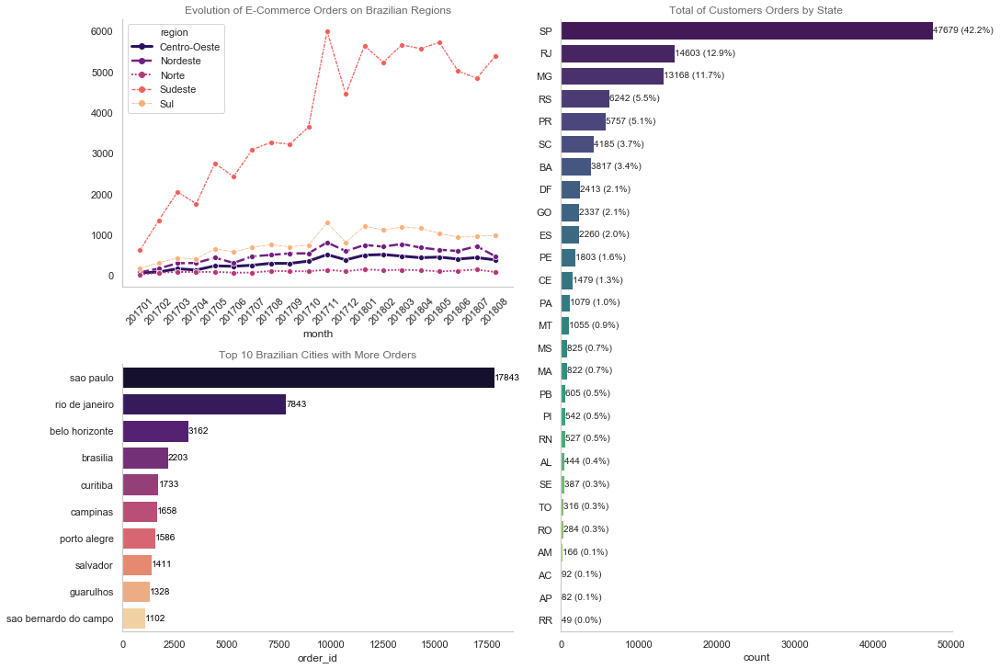

In [395]:
# Creating and preparing figure and axis 

fig = plt.figure(constrained_layout = True, figsize = (15, 10))
gs = GridSpec(2, 2, figure = fig)

ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[1, 0])
ax3 = fig.add_subplot(gs[:, 1])

# Count of orders by region 

sns.lineplot(x = 'month', y = 'order_count', ax = ax1, data = df_regions_group, hue = 'region', size = 'region', style = 'region', palette = 'magma', markers = ['o']*5)
format_spines(ax1, right_border = False)

ax1.set_title('Evolution of E-Commerce Orders on Brazilian Regions', size = 12, color = 'dimgrey')
ax1.set_ylabel('')
for tick in ax1.get_xticklabels():
    tick.set_rotation(45)
    
# Top cities with more customers orders in Brazil'

sns.barplot(y = 'geolocation_city', x = 'order_id', data = df_cities_group, ax = ax2, palette = 'magma')
AnnotateBars(n_dec =0, font_size = 10, color = 'black').horizontal(ax2)
format_spines(ax2, right_border = False)

ax2.set_title('Top 10 Brazilian Cities with More Orders', size = 12, color = 'dimgrey')
ax2.set_ylabel('')

# Total orders by state 

single_countplot(y = 'customer_state', ax = ax3, df = df_orders_filt, palette = 'viridis')

ax3.set_title('Total of Customers Orders by State', size = 12, color = 'dimgrey')
ax3.set_ylabel('')

plt.show()

    - How customers are distributed in Brazil> ( a 30k orders sample from 2017 in a map!

In [397]:
df_orders_items.head(5)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_purchase_year,order_purchase_month,order_purchase_month_name,order_purchase_year_month,order_purchase_date,order_purchase_day,order_purchase_dayofweek,order_purchase_dayofweek_name,order_purchase_hour,order_purchase_time_day,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,id,sigla,nome,nome_regiao,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,2017,10,Oct,201710,20171002,2,0,Mon,10,Morning,1.0,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,35,SP,São Paulo,Sudeste,3149.0,-23.583885,-46.587473,sao paulo,SP
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13,af07308b275d755c9edb36a90c618231,47813,barreiras,BA,2018,7,Jul,201807,20180724,24,1,Tue,20,Night,1.0,595fac2a385ac33a80bd5114aec74eb8,289cdb325fb7e7f891c38608bf9e0962,2018-07-30 03:24:27,118.70,22.76,29,BA,Bahia,Nordeste,47813.0,-12.945892,-45.016313,barreiras,BA
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04,3a653a41f6f9fc3d2a113cf8398680e8,75265,vianopolis,GO,2018,8,Aug,201808,20180808,8,2,Wed,8,Morning,1.0,aa4383b373c6aca5d8797843e5594415,4869f7a5dfa277a7dca6462dcf3b52b2,2018-08-13 08:55:23,159.90,19.22,52,GO,Goiás,Centro-Oeste,75265.0,-16.752735,-48.522139,vianopolis,GO
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15,7c142cf63193a1473d2e66489a9ae977,59296,sao goncalo do amarante,RN,2017,11,Nov,201711,20171118,18,5,Sat,19,Night,1.0,d0b61bfb1de832b15ba9d266ca96e5b0,66922902710d126a0e7d26b0e3805106,2017-11-23 19:45:59,45.00,27.20,24,RN,Rio Grande do Norte,Nordeste,59296.0,-5.778488,-35.281450,sao goncalo do amarante,RN
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26,72632f0f9dd73dfee390c9b22eb56dd6,9195,santo andre,SP,2018,2,Feb,201802,20180213,13,1,Tue,21,Night,1.0,65266b2da20d04dbe00c5c2d3bb7859e,2c9e548be18521d1c43cde1c582c6de8,2018-02-19 20:31:37,19.90,8.72,35,SP,São Paulo,Sudeste,9195.0,-23.760018,-46.524784,santo andre,SP


In [396]:
# Zipping locations 

lats = list(df_orders_items.query('order_purchase_year == 2018')['geolocation_lat'].dropna().values)[:30000]
longs = list(df_orders_items.query('order_purchase_year == 2018')['geolocation_lng'].dropna().values)[:30000]
locations = list(zip(lats, longs))

# Creating a map using folium
map1 = folium.Map(location = [-15, -50], zoom_start = 4.0)

# Plugin:FastMarkerCluster 

FastMarkerCluster(data = locations).add_to(map1)

map1


   - **Heat Map**: a good view to see where are the core of brazilian e-commrece customers 

In [403]:
# Grouping geolocation data for plotting a heatmap 

heat_data = df_orders_filt.groupby(by = ['geolocation_lat', 'geolocation_lng'], as_index = False).count().iloc[:, :3]

# Creating a map using folium

map1 = folium.Map(
                    location = [-15, -50], 
                    zoom_start = 4.0,
                    tiles = 'cartodbdark_matter')


# Pugin: HeatMap 

HeatMap(name = 'Mapa de Calor',
       data = heat_data,
       radius = 10,
       max_zoom = 13
       ).add_to(map1)

map1



**Nice!** Another good view is to use the folium plugin ``HeatMapWithTime`` to see the evolution of e-commerce orders among time.

For limitations purpose (i.e Jupyter and Chrome limitations for total number  of points shown at HeatMapWitTime, we will show the evolution of orders from January 2018 to July 2018)

Also, it's possible that the plugin HeatMapWithTime doesn't work property from a issue fixed on version 0.11 (it seems that the version of the kernel if 0.10). it is the case for you, just updating the version of folium library would fix it

In [405]:
df_orders_items.head(1)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_purchase_year,order_purchase_month,order_purchase_month_name,order_purchase_year_month,order_purchase_date,order_purchase_day,order_purchase_dayofweek,order_purchase_dayofweek_name,order_purchase_hour,order_purchase_time_day,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,id,sigla,nome,nome_regiao,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,2017,10,Oct,201710,20171002,2,0,Mon,10,Morning,1.0,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,35,SP,São Paulo,Sudeste,3149.0,-23.583885,-46.587473,sao paulo,SP


In [415]:
epoch_list = []

heatmap_evl_data = df_orders_items[(df_orders_items['order_purchase_year_month'].astype(int)>= 201701)]
heatmap_evl_data = heatmap_evl_data[(heatmap_evl_data['order_purchase_year_month'].astype(int)<= 201807)]
time_index = heatmap_evl_data['order_purchase_year_month'].sort_values().unique()

for epoch in time_index:
    data_temp = heatmap_evl_data.query('order_purchase_year_month == @epoch')
    data_temp = data_temp.groupby(by=['geolocation_lat', 'geolocation_lng'], as_index = False).count()
    data_temp = data_temp.sort_values(by = 'order_id', ascending = False).iloc[:, :3]
    epoch_list.append(data_temp.values.tolist())
    

# Creatiung a map using folium

map2 = folium.Map(location = [-15, -50],
                 zoom_start = 4.0,
                 tiles = 'cartodbdark_matter')

# Plugin:HeatMapWithTime

HeatMapWithTime(
    name = 'Evolution of Orders in a Geolocation Perspective',
    data =epoch_list,
    radius = 15, 
    index = list(time_index)
    ).add_to(map2)

map2

## E-Commerce Impact on Economy

- How about the e-commerce sales? Did they grow up over time?

In [224]:
# Grouping data 

df_month_aggreg = df_orders_filt.groupby(by = ['order_purchase_year', 'order_purchase_year_month'], as_index = False)

df_month_aggreg = df_month_aggreg.agg({
    'order_id' : 'count',
    'price' : 'sum',
    'freight_value' : 'sum'
})

# Adding new columns for analysis 

df_month_aggreg['price_per_order'] = df_month_aggreg['price'] / df_month_aggreg['order_id']
df_month_aggreg['freight_per_order'] = df_month_aggreg['freight_value'] /df_month_aggreg['order_id']

df_month_aggreg.head()

,order_purchase_year,order_purchase_year_month,order_id,price,freight_value,price_per_order,freight_per_order
0,2017,201701,966,120312.87,16875.62,124.547484,17.469586
1,2017,201702,1998,247303.02,38977.60,123.775285,19.508308
2,2017,201703,3041,374344.30,57704.29,123.099079,18.975432
3,2017,201704,2697,359927.23,52495.01,133.454664,19.464223
4,2017,201705,4176,506071.14,80119.81,121.185618,19.185778


Text(0.5, 0.36, 'R$7.39M')

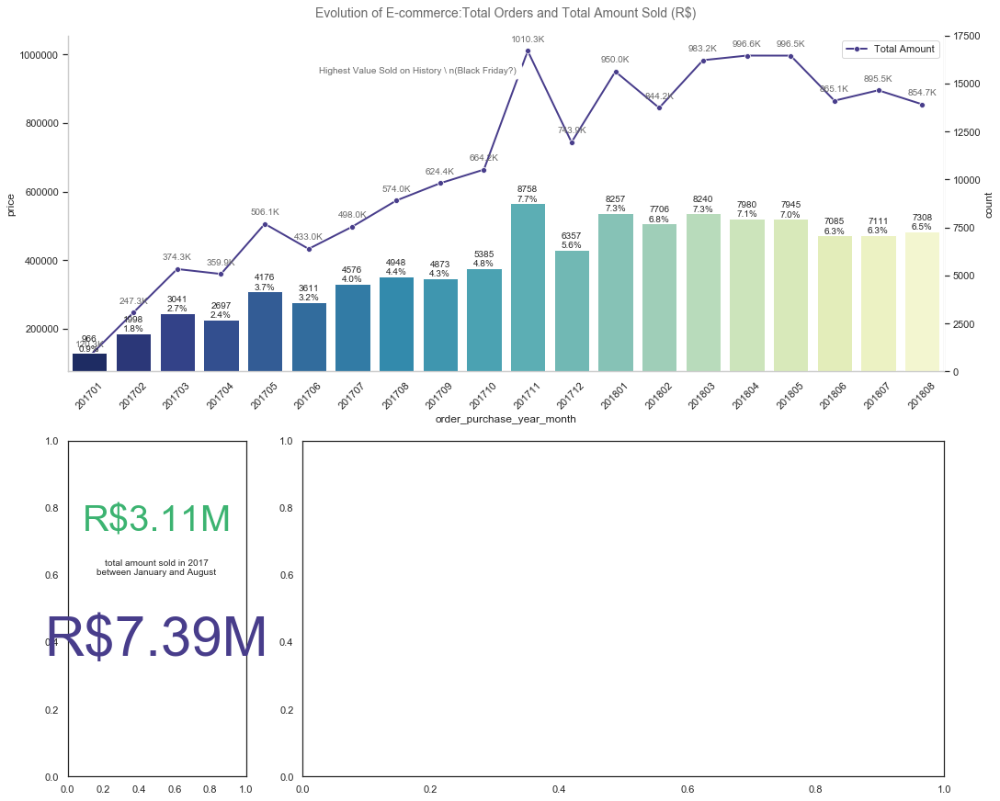

In [225]:
# Creating figure 

fig = plt.figure(constrained_layout = True, figsize = (15, 12))

# Creating figure Axis definition 

gs = GridSpec(2, 3, figure = fig)
ax1 = fig.add_subplot(gs[0, :])
ax2 = fig.add_subplot(gs[1, 0])
ax3 = fig.add_subplot(gs[1, 1:])

# Plot Evolution of total orders and total sales on e-commerce

sns.lineplot(x ='order_purchase_year_month', y = 'price', ax = ax1, data = df_month_aggreg, linewidth =2, color = 'darkslateblue', marker = 'o', label = 'Total Amount')
ax1_twx = ax1.twinx()
single_countplot(df_orders_filt, x = 'order_purchase_year_month', ax = ax1_twx, order = False, palette  = 'YlGnBu_r')
ax1_twx.set_yticks(np.arange(0, 20000, 2500))

# Customizing the first plot 

format_spines(ax1)
for tick in ax1.get_xticklabels():
    tick.set_rotation(45)

for x, y in df_month_aggreg.price.items():
    ax1.annotate(str(round(y/1000 , 1))+'K', xy = (x, y), textcoords = 'offset points', xytext = (0,10), ha = 'center', color = 'dimgrey')
    
ax1.annotate(f'Highest Value Sold on History \ n(Black Friday?)', xy = (10, 1000000), xytext = (-120, -20), textcoords = 'offset points', bbox =dict(boxstyle='round4', fc ='w', pad =.8),
             arrowprops = dict(arrowstyle = '-|>', fc = 'w'), color = 'dimgrey', ha = 'center')

ax1.set_title('Evolution of E-commerce:Total Orders and Total Amount Sold (R$)', size = 14, color = 'dimgrey', pad =20)

ax1.set_title('Evolution of E-commerce:Total Orders and Total Amount Sold (R$)', size = 14, color = 'dimgrey', pad =20)

month_comparison = ['201701', '201702', '201703', '201704', '201705', '201706', '201707', '201708', '201801', '201802', '201803', '201804', '201805', '201806', '201807', '201808']

df_sales_compare = df_month_aggreg.query('order_purchase_year_month in (@month_comparison)')
sold_2017 = df_sales_compare.query('order_purchase_year == 2017')['price'].sum()
sold_2018 = df_sales_compare.query('order_purchase_year == 2018')['price'].sum()
growth = 1+ (sold_2017/sold_2018)

ax2.text(0.50, 0.73, 'R$' + str(round(sold_2017/1000000, 2)) +'M', fontsize = 40, color = 'mediumseagreen', ha = 'center')
ax2.text(0.50, 0.60, 'total amount sold in 2017\nbetween January and August', fontsize = 10, ha ='center')
ax2.text(0.50, 0.36, 'R$' + str(round(sold_2018/1e6, 2)) + 'M', fontsize = 60, color ='darkslateblue', ha = 'center')

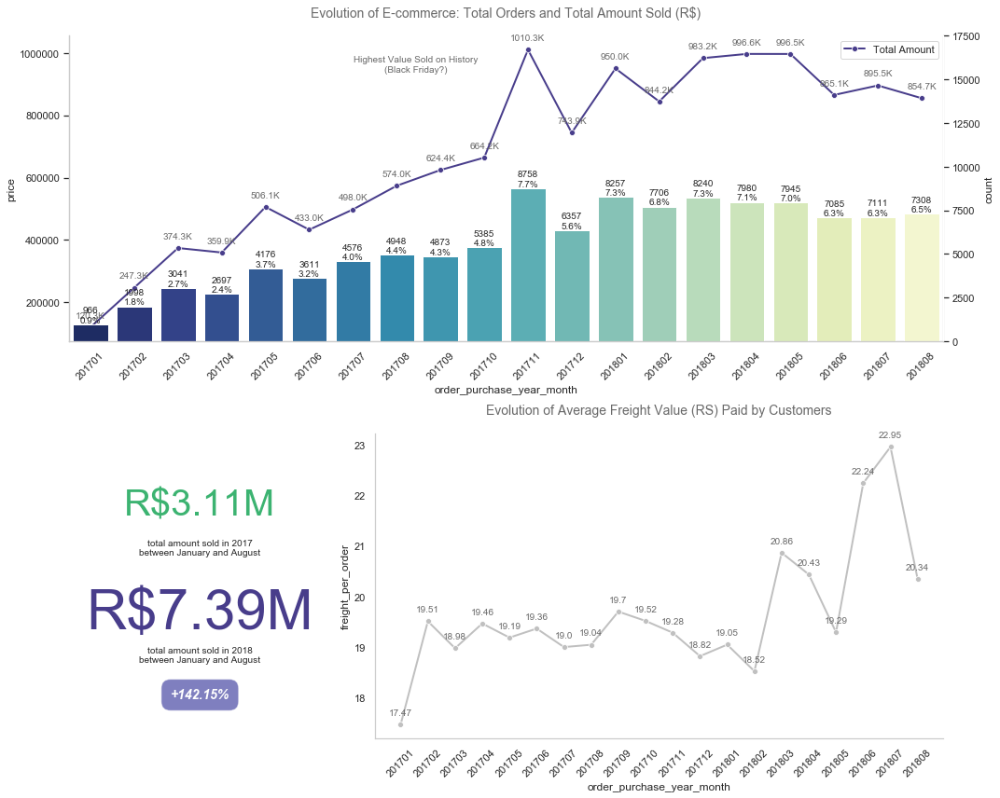

In [226]:
# Creating figure
fig = plt.figure(constrained_layout=True, figsize=(15, 12))

# Axis definition
gs = GridSpec(2, 3, figure=fig)
ax1 = fig.add_subplot(gs[0, :])
ax2 = fig.add_subplot(gs[1, 0])
ax3 = fig.add_subplot(gs[1, 1:])

# Plot 1 - Evolution of total orders and total sales on e-commerce
sns.lineplot(x='order_purchase_year_month', y='price', ax=ax1, data=df_month_aggreg, linewidth=2, 
             color='darkslateblue', marker='o', label='Total Amount')
ax1_twx = ax1.twinx()
single_countplot(df_orders_filt, x='order_purchase_year_month', ax=ax1_twx, order=False, palette='YlGnBu_r')
ax1_twx.set_yticks(np.arange(0, 20000, 2500))

# Customizing the first plot
format_spines(ax1)
for tick in ax1.get_xticklabels():
    tick.set_rotation(45)
for x, y in df_month_aggreg.price.items():
    ax1.annotate(str(round(y/1000, 1))+'K', xy=(x, y), textcoords='offset points', xytext=(0, 10),
                ha='center', color='dimgrey')
ax1.annotate(f'Highest Value Sold on History\n(Black Friday?)', (10, 1000000), xytext=(-120, -20), 
             textcoords='offset points', bbox=dict(boxstyle="round4", fc="w", pad=.8),
             arrowprops=dict(arrowstyle='-|>', fc='w'), color='dimgrey', ha='center')
ax1.set_title('Evolution of E-commerce: Total Orders and Total Amount Sold (R$)', size=14, color='dimgrey', pad=20)

# Plot 2 - Big Numbers of Sales Evolution
month_comparison = ['201701', '201702', '201703', '201704', '201705', '201706', '201707', '201708',
                    '201801', '201802', '201803', '201804', '201805', '201806', '201807', '201808']
df_sales_compare = df_month_aggreg.query('order_purchase_year_month in (@month_comparison)')
sold_2017 = df_sales_compare.query('order_purchase_year == 2017')['price'].sum()
sold_2018 = df_sales_compare.query('order_purchase_year == 2018')['price'].sum()
growth = 1 + (sold_2017 / sold_2018)
ax2.text(0.50, 0.73, 'R$' + str(round(sold_2017/1000000, 2)) + 'M', fontsize=40, color='mediumseagreen', ha='center')
ax2.text(0.50, 0.60, 'total amount sold in 2017\nbetween January and August', fontsize=10, ha='center')
ax2.text(0.50, 0.36, 'R$' + str(round(sold_2018/1000000, 2)) + 'M', fontsize=60, color='darkslateblue', ha='center')
ax2.text(0.50, 0.25, 'total amount sold in 2018\nbetween January and August', fontsize=10, ha='center')
signal = '+' if growth > 0 else '-'
ax2.text(0.50, 0.13, f'{signal}{str(round(100 * growth, 2))}%', fontsize=14, ha='center', color='white', style='italic', weight='bold',
         bbox=dict(facecolor='navy', alpha=0.5, pad=10, boxstyle='round, pad=.7'))
ax2.axis('off')

# Plot 3 - Evolution of mean freight value paid by the customers

sns.lineplot(x='order_purchase_year_month', y='freight_per_order', data=df_month_aggreg, linewidth=2, 
             color='silver', marker='o', ax=ax3)
format_spines(ax3, right_border=False)
for tick in ax3.get_xticklabels():
    tick.set_rotation(45)
for x, y in df_month_aggreg.freight_per_order.items():
    ax3.annotate(round(y, 2), xy=(x, y), textcoords='offset points', xytext=(0, 10),
                ha='center', color='dimgrey')
ax3.set_title('Evolution of Average Freight Value (RS) Paid by Customers', size=14, color='dimgrey', pad=20)

plt.tight_layout()
plt.show()

     - How the total sales (sum of price) are concentrated in Brazilian states?

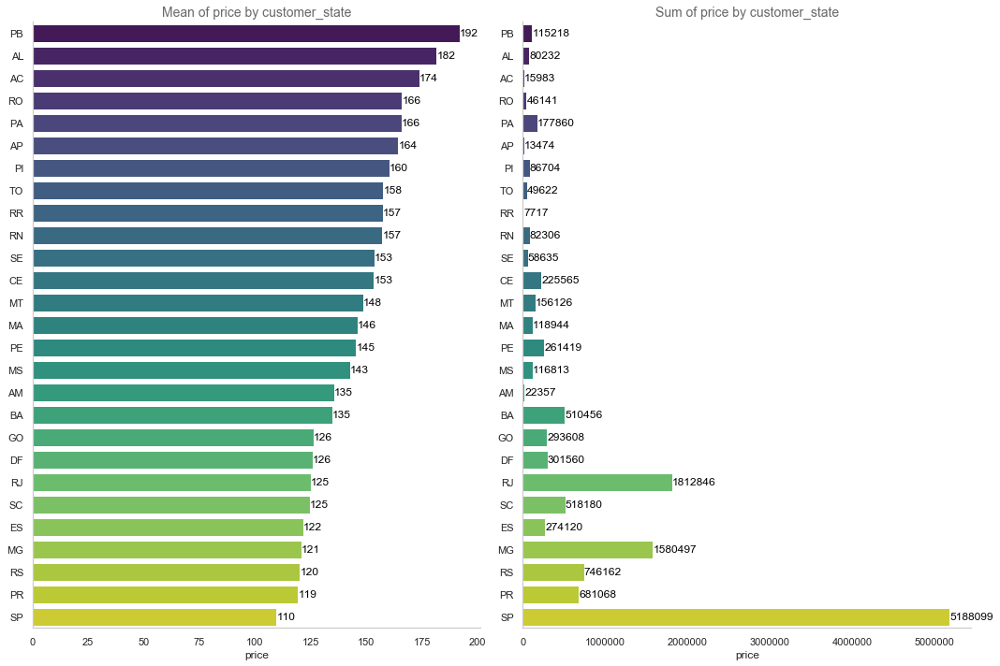

In [227]:
mean_sum_analysis(df_orders_filt, 'customer_state', 'price', palette = 'viridis', figsize = (15, 10))

Here we can get insights about the customers states with highest mean freight value. For example, customers in Roraima (RR), Paraiba (PB), Rondonia (RO) and Acre (AC) normally pays more than anyone on freights.

    - What are the best states to buy in Brazil? An analysis sales, freight and delivery time.

In [416]:
# Calculating working days between purchasing, delivering and estimated delivery
purchasing = df_orders_filt['order_purchase_timestamp']
delivered = df_orders_filt['order_delivered_customer_date']
estimated = df_orders_filt['order_estimated_delivery_date']
df_orders_filt['time_to_delivery'] = calc_working_days(purchasing, delivered, convert=True)
df_orders_filt['diff_estimated_delivery'] = calc_working_days(estimated, delivered, convert=True)

# Grouping data by state
states_avg_grouped = df_orders_filt.groupby(by='customer_state', as_index=False).mean()
states_freight_paid = states_avg_grouped.loc[:, ['customer_state', 'freight_value']]
states_time_to_delivery = states_avg_grouped.loc[:, ['customer_state', 'time_to_delivery']]
states_estimated_delivery = states_avg_grouped.loc[:, ['customer_state', 'diff_estimated_delivery']]

# Sorting data
states_freight_paid = states_freight_paid.sort_values(by='freight_value', ascending=False)
states_time_to_delivery = states_time_to_delivery.sort_values(by='time_to_delivery', ascending=False)
states_estimated_delivery = states_estimated_delivery.sort_values(by='diff_estimated_delivery')

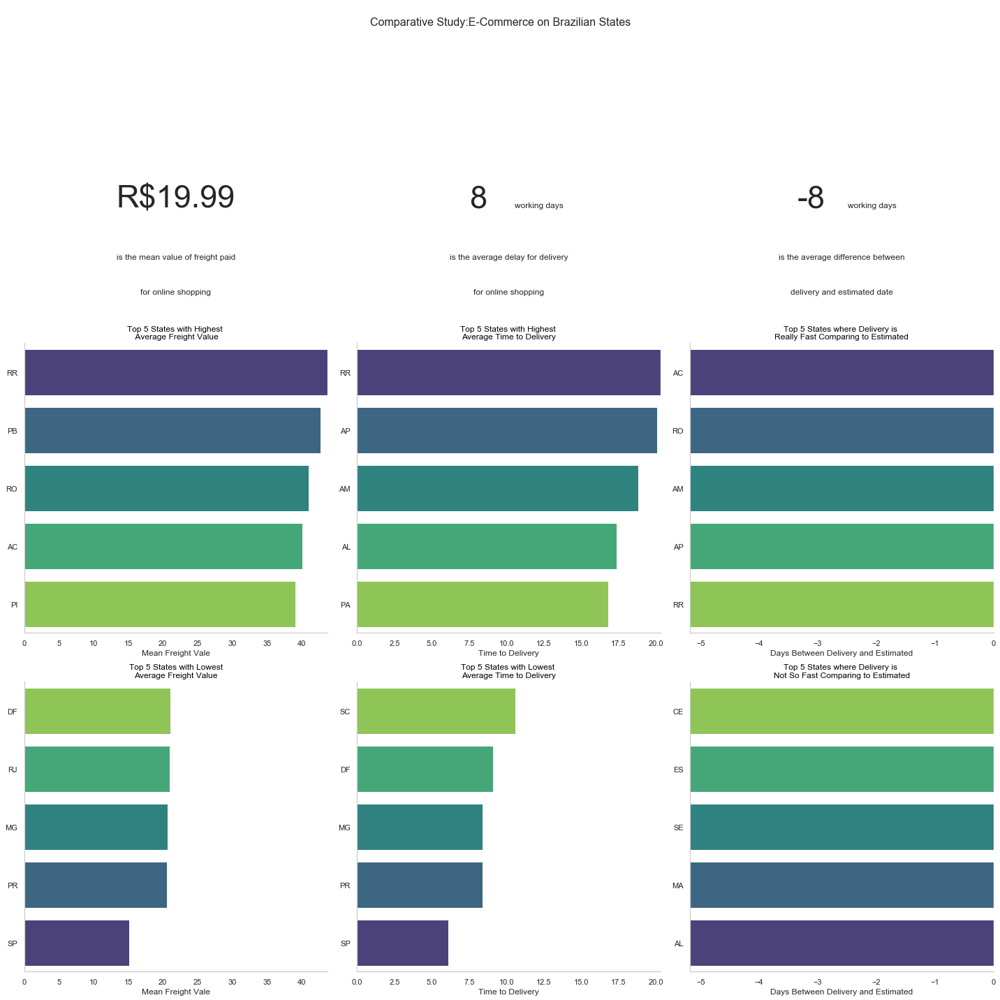

In [417]:
fig, axs = plt.subplots(3, 3, figsize = (20, 20))
ax1 = axs[1,0]
ax2 = axs[2,0]

# Plot Pack 01 - Freight value paid on states 

sns.barplot(x = 'freight_value', y = 'customer_state', data = states_freight_paid.head(), ax = ax1, palette = 'viridis')
ax1.set_title('Top 5 States with Highest \n Average Freight Value', size = 12, color = 'black')

sns.barplot(x = 'freight_value', y ='customer_state', data= states_freight_paid.tail(), ax = ax2, palette = 'viridis_r')
ax2.set_title('Top 5 States with Lowest\nAverage Freight Value', size = 12, color = 'black')

for ax in ax1, ax2:
     ax.set_xlabel('Mean Freight Vale')
     ax.set_xlim(0, states_freight_paid['freight_value'].max())
     format_spines(ax, right_border = False)
     ax.set_ylabel('')

# Annotations 

axs[0, 0].text(0.50, 0.30, f'R${round(df_orders_filt.freight_value.mean(),2)}', fontsize = 45, ha ='center')
axs[0, 0].text(0.50, 0.12, f'is the mean value of freight paid', fontsize = 12, ha = 'center')
axs[0, 0].text(0.50, 0.00, f'for online shopping', fontsize = 12, ha ='center')
axs[0, 0].axis('off')

# Plot Pack 02 - Time to delivery on states 

sns.barplot(x = 'time_to_delivery', y = 'customer_state', data = states_time_to_delivery.head(), 
            ax = axs[1, 1], palette = 'viridis')
            
axs[1, 1].set_title('Top 5 States with Highest \nAverage Time to Delivery', size = 12, color ='black')

sns.barplot(x = 'time_to_delivery', y ='customer_state', data = states_time_to_delivery.tail(), ax =axs[2, 1], palette = 'viridis_r')
axs[2, 1].set_title('Top 5 States with Lowest \nAverage Time to Delivery', size = 12, color = 'black')

for ax in axs[1, 1], axs[2, 1]:
    ax.set_xlabel('Time to Delivery')
    ax.set_xlim(0, states_time_to_delivery['time_to_delivery'].max())
    format_spines(ax, right_border = False)
    ax.set_ylabel('')

# Annotations

axs[0, 1].text(0.40, 0.30, f'{int(df_orders_filt.time_to_delivery.mean())}', fontsize = 45, ha ='center')
axs[0, 1].text(0.6, 0.3, 'working days', fontsize = 12, ha = 'center')
axs[0, 1].text(0.5, 0.12, 'is the average delay for delivery', fontsize = 12, ha ='center')
axs[0, 1].text(0.50, 0.00, 'for online shopping', fontsize = 12, ha ='center')
axs[0, 1].axis('off')

# Plot Pack 03 - Difference between delivered and estimated on states 

sns.barplot(x ='diff_estimated_delivery', y = 'customer_state', data = states_estimated_delivery.head(), ax =axs[1, 2], palette = 'viridis')
axs[1, 2].set_title('Top 5 States where Delivery is \nReally Fast Comparing to Estimated', size =12, color = 'black')

sns.barplot(x = 'diff_estimated_delivery', y ='customer_state', data = states_estimated_delivery.tail(), ax = axs[2, 2], palette = 'viridis_r')
axs[2, 2].set_title('Top 5 States where Delivery is \nNot So Fast Comparing to Estimated', size = 12, color = 'black')

for ax in axs[1, 2], axs[2, 2]:
    ax.set_xlabel('Days Between Delivery and Estimated')
    ax.set_xlim(states_estimated_delivery['diff_estimated_delivery'].min() - 1)
    ax.set_xlim(states_estimated_delivery['diff_estimated_delivery'].max()+1)
    format_spines(ax, right_border = False)
    ax.set_ylabel('')

# Annotations 

axs[0, 2].text(0.40, 0.30, f'{int(df_orders_filt.diff_estimated_delivery.mean())}', fontsize = 45, ha = 'center')
axs[0, 2].text(0.60, 0.30, 'working days', fontsize = 12, ha = 'center')
axs[0, 2].text(0.50, 0.12, 'is the average difference between', fontsize = 12, ha = 'center')
axs[0, 2].text(0.50, 0.00, 'delivery and estimated date', fontsize = 12, ha = 'center')
axs[0, 2].axis('off')

plt.suptitle('Comparative Study:E-Commerce on Brazilian States', size = 16)
plt.tight_layout()
plt.show()

## Payment Type Analysis

One of the datasets provided have informations about orders payment. To see how payments can take influence on e-commerce, we can build a mini-dashboard with main concepts: ``payments type`` and ``payment installments``. The idea is to present enough information to clarify how e-commerce buyers usually prefer to pay orders.

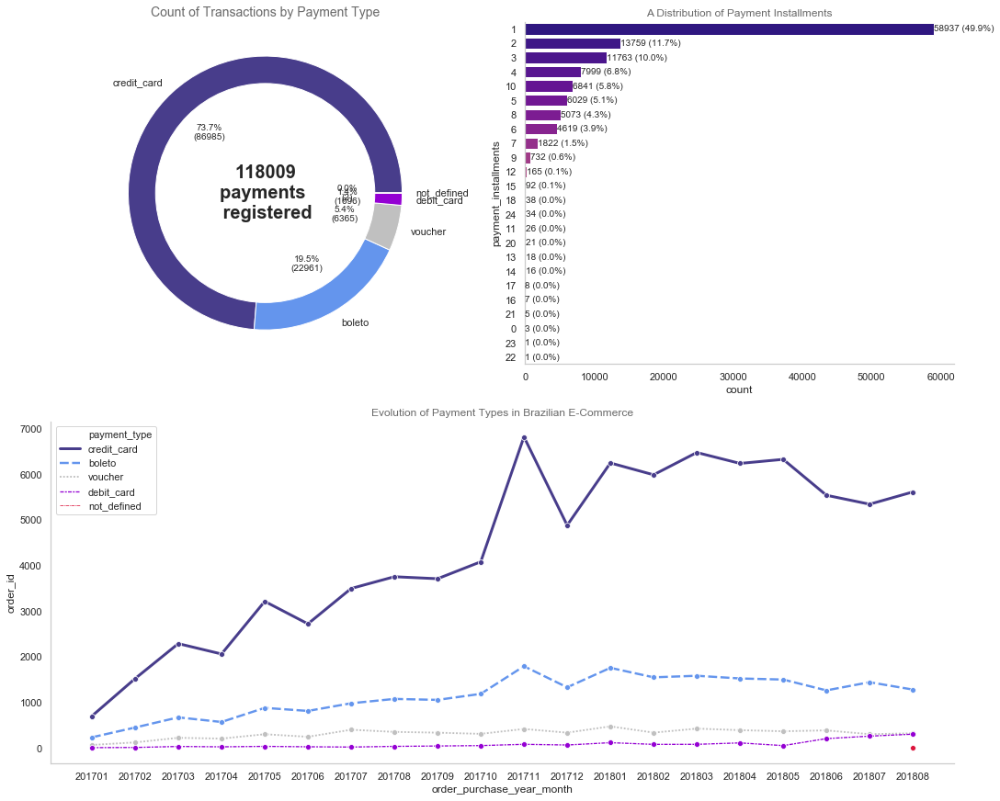

In [230]:
# Grouping data

df_orders_pay = df_orders_filt.merge(olist_order_payments, how = 'left', on ='order_id')

# Creating figure 

fig = plt.figure(constrained_layout = True, figsize = (15, 12))

# Axis definition 

gs = GridSpec(2, 2, figure = fig)
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])
ax3 = fig.add_subplot(gs[1, :])

# Plot 1 - Payment types in a donut chart 

colors = ['darkslateblue', 'cornflowerblue', 'silver', 'darkviolet', 'crimson']
label_names = df_orders_pay['payment_type'].value_counts().index
donut_plot(df_orders_pay, col ='payment_type', ax= ax1, label_names = label_names, colors = colors, title = 'Count of Transactions by Payment Type', text = f'{len(df_orders_pay)}\npayments \n registered')

# Plot 2 - Payment Installments 

single_countplot(df_orders_pay, ax = ax2, y ='payment_installments')
ax2.set_title('A Distribution of Payment Installments', color = 'dimgrey', size = 12)

# Plot 3 - Evolution of payment types 

payment_evl = df_orders_pay.groupby(by = ['order_purchase_year_month', 'payment_type'], as_index = False).count()
payment_evl = payment_evl.loc[:, ['order_purchase_year_month', 'payment_type', 'order_id']]
payment_evl = payment_evl.sort_values(by = ['order_purchase_year_month', 'order_id'], ascending = [True, False])

sns.lineplot(x = 'order_purchase_year_month', y = 'order_id', data = payment_evl, ax = ax3, hue = 'payment_type', style = 'payment_type', size = 'payment_type', palette = colors, marker = 'o' )

format_spines(ax3, right_border = False)
ax3.set_title('Evolution of Payment Types in Brazilian E-Commerce', size = 12, color = 'dimgrey')
plt.show()

    In fact, we can see by the line chart that payments made by credit card really took majority place on brazillian e-commerce. Besides that, since 201803 it's possible to see a little decrease on this type of payment. By the other side, payments made by debit card is showing a growing trend since 201805, which is a good opportunity for investor to improve services for payments like this.
    
    On the bar chart above, we can see how brazillian customers prefer to pay the orders: mostly of them pay once 1 installment and it's worth to point out the quantity of payments done by 1- installments.
    
    **Note: With tis, we close our session for EDA and now we can start the Natural Language Process step on reviews! Keep in touch for move!**
 

## Natural Language Processing

    As long as we could improve our relationship with the data, the path is open to start the Natural Language Processing step to analyze the comments left on e-commerce orders. The goal is to use this as input to a ``sentimental analysis`` model for understanding the customer's sentiment on purchasing things online. Let's take a look on the reviews data.

## Data Understanding 

In [425]:
df_comments = olist_order_reviews.loc[:, ['review_score', 'review_comment_message']]
df_comments = df_comments.dropna(subset = ['review_comment_message'])
df_comments = df_comments.reset_index(drop = True)

print(f'Dataset shape :{df_comments.shape}')
df_comments.columns = ['score', 'comment']

df_comments.head()

Dataset shape :(41753, 2)


,score,comment
0,5,Recebi bem antes do prazo estipulado.
1,5,Parabéns lojas lannister adorei comprar pela I...
2,4,aparelho eficiente. no site a marca do aparelh...
3,4,"Mas um pouco ,travando...pelo valor ta Boa.\r\n"
4,5,"Vendedor confiável, produto ok e entrega antes..."


So, we have in hands approximately 41k comments that could be used for training a sentimental analysis model. But, for this to becoming true, we have to go through a long  of text preparation to transform the comment input into a vector that can be interpreted for a Machine Learning model. **Let's go ahead**

## Regular Expressions

As long as we consider the global internet as the source of our comments, probably we have to deal with some HTML tags, break lines, special characters and other content that could be part of the dataset. Let's dig a little bit more on Regular Expressions to search for those patterns.

First of all, let's define a function that will be used for analysing the results of an applied regular expression. With this we can validate out text pre-processing in an easier way.

In [426]:
def find_patterns(re_pattern, text_list):
    """
    Args:
    ---------
    re_pattern: regular expression pattern to be used on search [type: string]
    text_list: list with text strings [type: list]
    
    Returns:
    positions_dict: python dictionary with key-value pars as below:
        text_idx: [(start_pattern1, end_pattern1), (start_pattern1, end_pattern2), ... (start_n, end_n)]
    """
    
    # Compiling the Regular Expression passed as a arg
    p = re.compile(re_pattern)
    positions_dict = {}
    i = 0
    for c in text_list:
        match_list = []
        iterator = p.finditer(c)
        for match in iterator:
            match_list.append(match.span())
        control_key = f'Text idx {i}'
        if len(match_list) == 0:
            pass
        else:
            positions_dict[control_key] = match_list
        i += 1
        
    """p = '[R]{0,1}\$[ ]{0,}\d+(,|\.)\d+'
    pattern_dict = find_patterns(p, reviews_breakline)
    print(len(pattern_dict))
    pattern_dict
    for idx in [int(c.split(' ')[-1]) for c in list(pattern_dict.keys())]:
        print(f'{reviews_breakline[idx]}\n')"""

    return positions_dict

def print_step_result(text_list_before, text_list_after, idx_list):
    """
    Args:
    ----------
    text_list_before: list object with text content before transformation [type: list]
    text_list_after: list object with text content after transformation [type: list]
    idx_list: list object with indexes to be printed [type: list]
    """
    
    # Iterating over string examples
    i = 1
    for idx in idx_list:
        print(f'--- Text {i} ---\n')
        print(f'Before: \n{text_list_before[idx]}\n')
        print(f'After: \n{text_list_after[idx]}\n')
        i += 1

### Breakline and Carriage Return

In [233]:
def re_breakline(text_list):
    """
    Args:
    ----------
    text_list: list object with text content to be prepared [type: list]
    """
    
    # Applying regex
    return [re.sub('[\n\r]', ' ', r) for r in text_list]

In [429]:
# Creating a list of comment reviews
reviews = list(df_comments['comment'].values)

# Applying RegEx
reviews_breakline = re_breakline(reviews)
df_comments['re_breakline'] = reviews_breakline

# Verifying results
print_step_result(reviews, reviews_breakline, idx_list=[48])

--- Text 1 ---

Before: 
Estava faltando apenas um produto, eu recebi hoje , muito obrigada!
Tudo certo!

Att 

Elenice.

After: 
Estava faltando apenas um produto, eu recebi hoje , muito obrigada!  Tudo certo!    Att     Elenice.



#### 4 Sitesd and Hiperlinks 

In [430]:
def re_hiperlinks(text_list):
    """
    Args:
    ----------
    text_list: list object with text content to be prepared [type: list]
    """
    
    # Applying regex
    pattern = 'http[s]?://(?:[a-zA-Z]|[0-9]|[$-_@.&+]|[!*\(\),]|(?:%[0-9a-fA-F][0-9a-fA-F]))+'
    return [re.sub(pattern, ' link ', r) for r in text_list]

In [236]:
# Applying RegEx
reviews_hiperlinks = re_hiperlinks(reviews_breakline)
df_comments['re_hiperlinks'] = reviews_hiperlinks

# Verifying results
print_step_result(reviews_breakline, reviews_hiperlinks, idx_list=[10796, 12782])

--- Text 1 ---

Before: 
comprei o produto pela cor ilustrada pelo site da loja americana, no site mostra ser preto http://prntscr.com/jkx7hr quando o produto chegou aqui veio todos com a mesma cor, tabaco http://prntscr.com/

After: 
comprei o produto pela cor ilustrada pelo site da loja americana, no site mostra ser preto  link  quando o produto chegou aqui veio todos com a mesma cor, tabaco  link 

--- Text 2 ---

Before: 
Pedi esse: https://www.lannister.com.br/produto/22880118/botox-capilar-selafix-argan-premium-doux-clair-2x1-litro?pfm_carac=doux%20clair&pfm_index=3&pfm_page=search&pfm_pos=grid&pfm_type=search_page%

After: 
Pedi esse:  link 



###  Dates 

In [431]:
def re_dates(text_list):
    """
    Args:
    ----------
    text_list: list object with text content to be prepared [type: list]
    """
    
    # Applying regex
    pattern = '([0-2][0-9]|(3)[0-1])(\/|\.)(((0)[0-9])|((1)[0-2]))(\/|\.)\d{2,4}'
    return [re.sub(pattern, ' data ', r) for r in text_list]

In [432]:
# Applying RegEx
reviews_dates = re_dates(reviews_hiperlinks)
df_comments['re_dates'] = reviews_dates

# Verifying results
print_step_result(reviews_hiperlinks, reviews_dates, idx_list=[26665, 41497, 41674])

--- Text 1 ---

Before: 
(tenso) tinhas mais de 10 lojas pra min escolher qual comprar, o pitei pela lannister por ser uma loja conhecida a entrega estava para dia 22/01/2018 . hoje já é 24/01/2018 pois comprei dia 06/01/18

After: 
(tenso) tinhas mais de 10 lojas pra min escolher qual comprar, o pitei pela lannister por ser uma loja conhecida a entrega estava para dia  data  . hoje já é  data  pois comprei dia  data 

--- Text 2 ---

Before: 
COMPREI EM 21/03/2018, PG VIA CARTÃO EM 21/03/2018, NF FOI EMITIDA DIA 27/03/2018, PREVISÃO ENTREGA EM 12/04/2018, HOJE É 14/04/2018, NÃO RECEBI, NÃO ESTÁ EM TRANSPORTE, ESTOU MUITO PREOCUPADO

After: 
COMPREI EM  data , PG VIA CARTÃO EM  data , NF FOI EMITIDA DIA  data , PREVISÃO ENTREGA EM  data , HOJE É  data , NÃO RECEBI, NÃO ESTÁ EM TRANSPORTE, ESTOU MUITO PREOCUPADO

--- Text 3 ---

Before: 
Já comprei várias vezes no site "lannister";mas  desta última vez,fiz uma compra de um TONER no  04.10.16 e só prometeram p/ 25.11.16 e ainda não  rece

### Money 

In [239]:
def re_money(text_list):
    """
    Args:
    ----------
    text_list: list object with text content to be prepared [type: list]
    """
    
    # Applying regex
    pattern = '[R]{0,1}\$[ ]{0,}\d+(,|\.)\d+'
    return [re.sub(pattern, ' dinheiro ', r) for r in text_list]

In [240]:
# Applying RegEx
reviews_money = re_money(reviews_dates)
df_comments['re_money'] = reviews_money

# Verifying results
print_step_result(reviews_dates, reviews_money, idx_list=[26020, 33297, 32998])

--- Text 1 ---

Before: 
Recebi o produto correto, porém o valor do produto na NF ficou a menor, R$ 172,00 sendo que comprei a 219,90.  O valor do frete calculado foi R$ 18,90 e veio R$ 93,00.  Gostaria que viesse com correto

After: 
Recebi o produto correto, porém o valor do produto na NF ficou a menor,  dinheiro  sendo que comprei a 219,90.  O valor do frete calculado foi  dinheiro  e veio  dinheiro .  Gostaria que viesse com correto

--- Text 2 ---

Before: 
Infelizmente, para uma entrega em GRU (Região Metropolitana da Grande SP) achei bem "salgado" o valor do frete cobrado sobre o preço do produto! Afinal, a mercadoria custou R$26,70 + R$15,11 de frete!

After: 
Infelizmente, para uma entrega em GRU (Região Metropolitana da Grande SP) achei bem "salgado" o valor do frete cobrado sobre o preço do produto! Afinal, a mercadoria custou  dinheiro  +  dinheiro  de frete!

--- Text 3 ---

Before: 
Paguei $48,00 reais de frete e acabei tendo que buscar o pedido no Centro de Distribuição 

### Numbers

In [434]:
def re_numbers(text_list):
    """
    Args:
    ----------
    text_series: list object with text content to be prepared [type: list]
    """
    
    # Applying regex
    return [re.sub('[0-9]+', ' numero ', r) for r in text_list]

In [436]:
reviews_numbers = re_numbers(reviews_money)
df_comments['re_numbers'] = reviews_numbers

# Verifying results
print_step_result(reviews_money, reviews_numbers, idx_list=[68])

--- Text 1 ---

Before: 
Comprei o produto dia 25 de fevereiro e hoje dia 29 de marco não fora entregue na minha residência. Não sei se os correios desse Brasil e péssimo ou foi a própria loja que demorou postar.

After: 
Comprei o produto dia  numero  de fevereiro e hoje dia  numero  de marco não fora entregue na minha residência. Não sei se os correios desse Brasil e péssimo ou foi a própria loja que demorou postar.



### Negation 

In [437]:
def re_negation(text_list):
    """
    Args:
    ----------
    text_series: list object with text content to be prepared [type: list]
    """
    
    # Applying regex
    return [re.sub('([nN][ãÃaA][oO]|[ñÑ]| [nN] )', ' negação ', r) for r in text_list]

In [439]:
# Applying RegEx
reviews_negation = re_negation(reviews_numbers)
df_comments['re_negation'] = reviews_negation

# Verifying results
print_step_result(reviews_numbers, reviews_negation, idx_list=[4783, 4627, 4856, 4904])

--- Text 1 ---

Before: 
O material é bom, o problema é que a bolsa não fecha, não possui zíper, é como uma sacola. Isso me deixou insatisfeita, pois na foto não dá pra perceber e não há informação ou foto interna sobre isso.

After: 
O material é bom, o problema é que a bolsa  negação  fecha,  negação  possui zíper, é como uma sacola. Isso me deixou insatisfeita, pois na foto  negação  dá pra perceber e  negação  há informação ou foto interna sobre isso.

--- Text 2 ---

Before: 
Meu pedido era para ser entregue até dia  data , até a presente data ( numero / numero ) a nota fiscal não foi emitida, solicitei várias vezes não obtive retorno, não recomendo esta Loja, nem a lannister!!!!!!

After: 
Meu pedido era para ser entregue até dia  data , até a presente data ( numero / numero ) a nota fiscal  negação  foi emitida, solicitei várias vezes  negação  obtive retorno,  negação  recomendo esta Loja, nem a lannister!!!!!!

--- Text 3 ---

Before: 
OEQUIPAMENTO NÃO FUNCIONA. O mini cartao 

### Special Characters 

In [441]:
def re_special_chars(text_list):
    """
    Args:
    ----------
    text_series: list object with text content to be prepared [type: list]
    """
    
    # Applying regex
    return [re.sub('\W', ' ', r) for r in text_list]

In [443]:
# Applying RegEx
reviews_special_chars = re_special_chars(reviews_negation)
df_comments['re_special_chars'] = reviews_special_chars

# Verifying results
print_step_result(reviews_negation, reviews_special_chars, idx_list=[45, 135, 234])

--- Text 1 ---

Before: 
Este foi o pedido  Balde Com  numero  Peças - Blocos De Montar  numero  un -  dinheiro  cada ( negação  FOI ENTREGUE)  Vendido e entregue targaryen  Tapete de Eva Nº Letras  numero  Peças Crianças  numero  un -  dinheiro  (ESTE FOI ENTREG

After: 
Este foi o pedido  Balde Com  numero  Peças   Blocos De Montar  numero  un    dinheiro  cada   negação  FOI ENTREGUE   Vendido e entregue targaryen  Tapete de Eva Nº Letras  numero  Peças Crianças  numero  un    dinheiro   ESTE FOI ENTREG

--- Text 2 ---

Before: 
Cada vez que compro mais fico satisfeita parabéns pela honestidade com seus clientes 👏👏👏👏?

After: 
Cada vez que compro mais fico satisfeita parabéns pela honestidade com seus clientes      

--- Text 3 ---

Before: 
Comprei o produto, paguei no boleto e só recebi metade do produto, anunciaram uma coisa é mandaram outra. Muito insatisfeita 😡😡😡

After: 
Comprei o produto  paguei no boleto e só recebi metade do produto  anunciaram uma coisa é mandaram outra  M

### Additional Whitespaces 

In [445]:
def re_whitespaces(text_list):
    """
    Args:
    ----------
    text_series: list object with text content to be prepared [type: list]
    """
    
    # Applying regex
    white_spaces = [re.sub('\s+', ' ', r) for r in text_list]
    white_spaces_end = [re.sub('[ \t]+$', '', r) for r in white_spaces]
    return white_spaces_end

In [447]:
# Applying RegEx
reviews_whitespaces = re_whitespaces(reviews_special_chars)
df_comments['re_whitespaces'] = reviews_whitespaces

# Verifying results
print_step_result(reviews_special_chars, reviews_whitespaces, idx_list=[3, 4, -1])

--- Text 1 ---

Before: 
Mas um pouco  travando   pelo valor ta Boa   

After: 
Mas um pouco travando pelo valor ta Boa

--- Text 2 ---

Before: 
Vendedor confiável  produto ok e entrega antes do prazo 

After: 
Vendedor confiável produto ok e entrega antes do prazo

--- Text 3 ---

Before: 
meu produto chegou e ja tenho que devolver  pois está com defeito    negação  segurar carga

After: 
meu produto chegou e ja tenho que devolver pois está com defeito negação segurar carga



### Stopwords 

In [448]:
# Examples of some portuguese stopwords
pt_stopwords = stopwords.words('portuguese')
print(f'Total portuguese stopwords in the nltk.corpous module: {len(pt_stopwords)}')
pt_stopwords[:10]

Total portuguese stopwords in the nltk.corpous module: 204


['de', 'a', 'o', 'que', 'e', 'é', 'do', 'da', 'em', 'um']

In [450]:
# Defining a function to remove the stopwords and to lower the comments
def stopwords_removal(text, cached_stopwords=stopwords.words('portuguese')):
    """
    Args:
    ----------
    text: list object where the stopwords will be removed [type: list]
    cached_stopwords: stopwords to be applied on the process [type: list, default: stopwords.words('portuguese')]
    """
    
    return [c.lower() for c in text.split() if c.lower() not in cached_stopwords]

In [451]:
# Removing stopwords and looking at some examples
reviews_stopwords = [' '.join(stopwords_removal(review)) for review in reviews_whitespaces]
df_comments['stopwords_removed'] = reviews_stopwords

print_step_result(reviews_whitespaces, reviews_stopwords, idx_list=[0, 45, 500])

--- Text 1 ---

Before: 
Recebi bem antes do prazo estipulado

After: 
recebi bem antes prazo estipulado

--- Text 2 ---

Before: 
Este foi o pedido Balde Com numero Peças Blocos De Montar numero un dinheiro cada negação FOI ENTREGUE Vendido e entregue targaryen Tapete de Eva Nº Letras numero Peças Crianças numero un dinheiro ESTE FOI ENTREG

After: 
pedido balde numero peças blocos montar numero un dinheiro cada negação entregue vendido entregue targaryen tapete eva nº letras numero peças crianças numero un dinheiro entreg

--- Text 3 ---

Before: 
O produto negação é bom

After: 
produto negação bom



### Stemming 

In [453]:
def stemming_process(text, stemmer=RSLPStemmer()):
    nltk.download('rslp')
    """
    Args:
    ----------
    text: list object where the stopwords will be removed [type: list]
    stemmer: type of stemmer to be applied [type: class, default: RSLPStemmer()]
    """
    return [stemmer.stem(c) for c in text.split()]

In [454]:
# Applying stemming and looking at some examples
reviews_stemmer = [' '.join(stemming_process(review)) for review in reviews_stopwords]
df_comments['stemming'] = reviews_stemmer

print_step_result(reviews_stopwords, reviews_stemmer, idx_list=[0, 45, -1])

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

--- Text 1 ---

Before: 
recebi bem antes prazo estipulado

After: 
receb bem ant praz estipul

--- Text 2 ---

Before: 
pedido balde numero peças blocos montar numero un dinheiro cada negação entregue vendido entregue targaryen tapete eva nº letras numero peças crianças numero un dinheiro entreg

After: 
ped bald numer peç bloc mont numer un dinh cad neg entreg vend entreg targaryen tapet eva nº letr numer peç crianç numer un dinh entreg

--- Text 3 ---

Before: 
produto chegou ja devolver pois defeito negação segurar carga

After: 
produt cheg ja devolv poi defeit neg segur carg




[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_

### Feature Extraction

In [455]:
def extract_features_from_corpus(corpus, vectorizer, df=False):
    """
    Args
    ------------
    text: text to be transformed into a document-term matrix [type: string]
    vectorizer: engine to be used in the transformation [type: object]
    """
    
    # Extracting features
    corpus_features = vectorizer.fit_transform(corpus).toarray()
    features_names = vectorizer.get_feature_names()
    
    # Transforming into a dataframe to give interpetability to the process
    df_corpus_features = None
    if df:
        df_corpus_features = pd.DataFrame(corpus_features, columns=features_names)
    
    return corpus_features, df_corpus_features

### CountVectorizer

In [456]:
count_vectorizer = CountVectorizer(max_features=300, min_df=7, max_df=0.8, stop_words=pt_stopwords)

# Extracting features for the corpus
countv_features, df_countv_features = extract_features_from_corpus(reviews_stemmer, count_vectorizer, df=True)
print(f'Shape of countv_features matrix: {countv_features.shape}\n')
print(f'Example of DataFrame of corpus features:')
df_countv_features.head()

Shape of countv_features matrix: (41753, 300)

Example of DataFrame of corpus features:


,abr,acab,ach,acontec,acord,ador,adquir,agor,aguard,aind,algum,além,amass,ame,ant,anunci,anúnci,apen,apes,após,assim,ate,atend,atras,avali,avis,baix,baratheon,bast,bem,boa,bols,bom,bonit,busc,cab,cad,cade,caix,cancel,cap,car,cart,cartuch,cas,celul,cert,cheg,client,cobr,...,satisf,satisfeit,segund,sei,seman,sempr,send,ser,serviç,sid,sim,sit,so,sobr,solicit,solt,soment,stark,sup,super,tamanh,tapet,targaryen,tec,temp,tent,ter,test,tod,total,trabalh,transport,troc,tud,unidad,us,uso,vai,val,vc,vei,vem,vend,ver,vez,vier,volt,vou,ótim,únic
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0


### TF-IDF

With the Bag of Words approach, each words has the same weight, wich maybe can't be true all the time, mainly for those words with a really low frequency on the corpus. So, the TF-IDF (Term Frequency and Inverse Document Frequency) approach can be used with the scikit-learn library following the formulas:

TF=Frequency of a word in the document/Total words in the document
 
IDF=log(Total number of docs/Number of docs containing the words)

In [256]:
# Creating an object for the CountVectorizer class
tfidf_vectorizer = TfidfVectorizer(max_features=300, min_df=7, max_df=0.8, stop_words=pt_stopwords)

# Extracting features for the corpus
tfidf_features, df_tfidf_features = extract_features_from_corpus(reviews_stemmer, tfidf_vectorizer, df=True)
print(f'Shape of tfidf_features matrix: {tfidf_features.shape}\n')
print(f'Example of DataFrame of corpus features:')
df_tfidf_features.head()

Shape of tfidf_features matrix: (41753, 300)

Example of DataFrame of corpus features:


,abr,acab,ach,acontec,acord,ador,adquir,agor,aguard,aind,algum,além,amass,ame,ant,anunci,anúnci,apen,apes,após,assim,ate,atend,atras,avali,avis,baix,baratheon,bast,bem,boa,bols,bom,bonit,busc,cab,cad,cade,caix,cancel,cap,car,cart,cartuch,cas,celul,cert,cheg,client,cobr,...,satisf,satisfeit,segund,sei,seman,sempr,send,ser,serviç,sid,sim,sit,so,sobr,solicit,solt,soment,stark,sup,super,tamanh,tapet,targaryen,tec,temp,tent,ter,test,tod,total,trabalh,transport,troc,tud,unidad,us,uso,vai,val,vc,vei,vem,vend,ver,vez,vier,volt,vou,ótim,únic
0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.351981,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.427963,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.320276,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.312579,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.168564,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.264843,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.300273,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.511137,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.591683,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.284558,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.460496,0.0,0.000000,0.0,0.0,0.0,0.0,0.0


The attributes used during the instancing of each vectorizer objects can be explained as:

max_features=300: indicates that the matrix will be created using the 300 most common words from the corpus
max_df=0.8: indicates that we will use only words with at least 80% frequency in the corpus
min_df=7: indicates that we will use only words that occurs in at least 7 text strings in the corpus

### Labelling Data

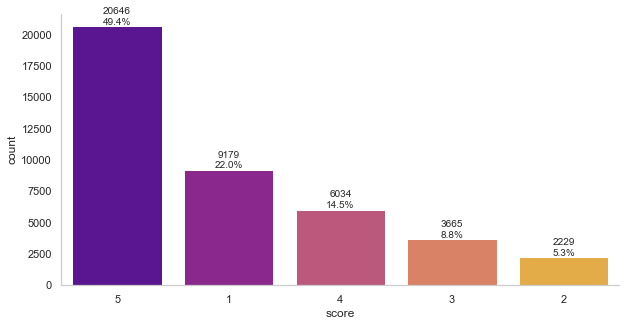

In [257]:
fig, ax = plt.subplots(figsize=(10, 5))
single_countplot(x='score', df=df_comments, ax=ax)

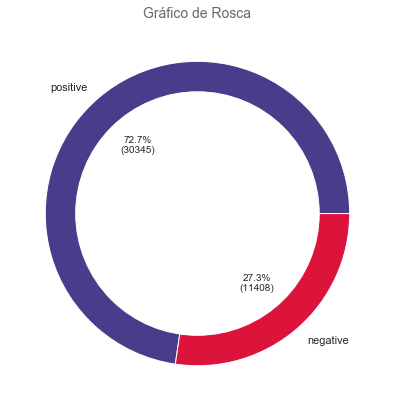

In [258]:
# Labelling data
score_map = {
    1: 'negative',
    2: 'negative',
    3: 'positive',
    4: 'positive',
    5: 'positive'
}
df_comments['sentiment_label'] = df_comments['score'].map(score_map)

# Verifying results
fig, ax = plt.subplots(figsize=(7, 7))
donut_plot(df_comments.query('sentiment_label in ("positive", "negative")'), 'sentiment_label', 
           label_names=df_comments.query('sentiment_label in ("positive", "negative")')['sentiment_label'].value_counts().index,
           ax=ax, colors=['darkslateblue', 'crimson'])

           - What's the main n-grams presentes in corpus on positive and negative classes?

In [259]:
def ngrams_count(corpus, ngram_range, n=-1, cached_stopwords=stopwords.words('portuguese')):
    """
    Args
    ----------
    corpus: text to be analysed [type: pd.DataFrame]
    ngram_range: type of n gram to be used on analysis [type: tuple]
    n: top limit of ngrams to be shown [type: int, default: -1]
    """
    
    # Using CountVectorizer to build a bag of words using the given corpus
    vectorizer = CountVectorizer(stop_words=cached_stopwords, ngram_range=ngram_range).fit(corpus)
    bag_of_words = vectorizer.transform(corpus)
    sum_words = bag_of_words.sum(axis=0)
    words_freq = [(word, sum_words[0, idx]) for word, idx in vectorizer.vocabulary_.items()]
    words_freq = sorted(words_freq, key=lambda x: x[1], reverse=True)
    total_list = words_freq[:n]
    
    # Returning a DataFrame with the ngrams count
    count_df = pd.DataFrame(total_list, columns=['ngram', 'count'])
    return count_df

In [260]:
# Splitting the corpus into positive and negative comments
positive_comments = df_comments.query('sentiment_label == "positive"')['stemming']
negative_comments = df_comments.query('sentiment_label == "negative"')['stemming']

# Extracting the top 10 unigrams by sentiment
unigrams_pos = ngrams_count(positive_comments, (1, 1), 10)
unigrams_neg = ngrams_count(negative_comments, (1, 1), 10)

# Extracting the top 10 unigrams by sentiment
bigrams_pos = ngrams_count(positive_comments, (2, 2), 10)
bigrams_neg = ngrams_count(negative_comments, (2, 2), 10)

# Extracting the top 10 unigrams by sentiment
trigrams_pos = ngrams_count(positive_comments, (3, 3), 10)
trigrams_neg = ngrams_count(negative_comments, (3, 3), 10)

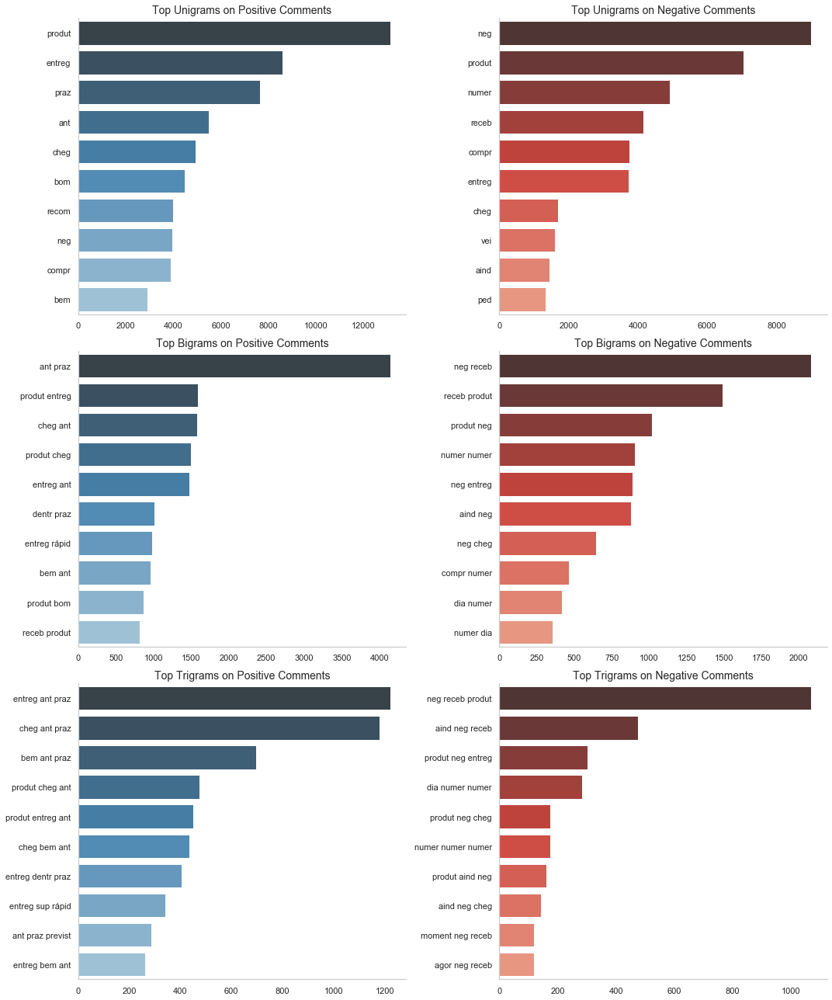

In [261]:
# Joining everything in a python dictionary to make the plots easier
ngram_dict_plot = {
    'Top Unigrams on Positive Comments': unigrams_pos,
    'Top Unigrams on Negative Comments': unigrams_neg,
    'Top Bigrams on Positive Comments': bigrams_pos,
    'Top Bigrams on Negative Comments': bigrams_neg,
    'Top Trigrams on Positive Comments': trigrams_pos,
    'Top Trigrams on Negative Comments': trigrams_neg,
}

# Plotting the ngrams analysis
fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(15, 18))
i, j = 0, 0
colors = ['Blues_d', 'Reds_d']
for title, ngram_data in ngram_dict_plot.items():
    ax = axs[i, j]
    sns.barplot(x='count', y='ngram', data=ngram_data, ax=ax, palette=colors[j])
    
    # Customizing plots
    format_spines(ax, right_border=False)
    ax.set_title(title, size=14)
    ax.set_ylabel('')
    ax.set_xlabel('')
    
    # Incrementing the index
    j += 1
    if j == 2:
        j = 0
        i += 1
plt.tight_layout()
plt.show()

The barcharts above are interesting and they really reflect the sentiment based on ngrams. We can clearly see negative words on bigrams and trigrams by the right side of the figure (the most frequent trigram neg receb produt in english maybe means something like didn't receive the product for example).

The positive bigrams and trigrams at the blue left side of the figure really consists of positive words (the most frequent trigram entreg ant praz means something like delivery before time in english). Also!

### Pipeline

In [262]:
# Class for regular expressions application
class ApplyRegex(BaseEstimator, TransformerMixin):
    
    def __init__(self, regex_transformers):
        self.regex_transformers = regex_transformers
        
    def fit(self, X, y=None):
        return self
    
    def transform(self, X, y=None):
        # Applying all regex functions in the regex_transformers dictionary
        for regex_name, regex_function in self.regex_transformers.items():
            X = regex_function(X)
            
        return X

# Class for stopwords removal from the corpus
class StopWordsRemoval(BaseEstimator, TransformerMixin):
    
    def __init__(self, text_stopwords):
        self.text_stopwords = text_stopwords
    def fit(self, X, y=None):
        return self
    
    def transform(self, X, y=None):
        return [' '.join(stopwords_removal(comment, self.text_stopwords)) for comment in X]

# Class for apply the stemming process
class StemmingProcess(BaseEstimator, TransformerMixin):
    
    def __init__(self, stemmer):
        self.stemmer = stemmer
    
    def fit(self, X, y=None):
        return self
    
    def transform(self, X, y=None):
        return [' '.join(stemming_process(comment, self.stemmer)) for comment in X]
    
# Class for extracting features from corpus
class TextFeatureExtraction(BaseEstimator, TransformerMixin):
    
    def __init__(self, vectorizer):
        self.vectorizer = vectorizer
        
    def fit(self, X, y=None):
        return self
    
    def transform(self, X, y=None):
        return self.vectorizer.fit_transform(X).toarray()

In [263]:
# Defining regex transformers to be applied
regex_transformers = {
    'break_line': re_breakline,
    'hiperlinks': re_hiperlinks,
    'dates': re_dates,
    'money': re_money,
    'numbers': re_numbers,
    'negation': re_negation,
    'special_chars': re_special_chars,
    'whitespaces': re_whitespaces
}

# Defining the vectorizer to extract features from text
vectorizer = TfidfVectorizer(max_features=300, min_df=7, max_df=0.8, stop_words=pt_stopwords)

# Building the Pipeline
text_pipeline = Pipeline([
    ('regex', ApplyRegex(regex_transformers)),
    ('stopwords', StopWordsRemoval(stopwords.words('portuguese'))),
    ('stemming', StemmingProcess(RSLPStemmer())),
    ('text_features', TextFeatureExtraction(vectorizer))
    ])

Just to remember, in the pipeline above we chose the TF-IDF approach to extract features from text using the same parameters we used on the examples (max_features=300, min_df=7, max_df=0.8). It means that every text string in our corpus will be 300 "text features" respecting the criteria defined by the min_df and max_df parameters. Let's apply it.



In [264]:
idx_reviews = olist_order_reviews['review_comment_message'].dropna().index
score = olist_order_reviews['review_score'][idx_reviews].map(score_map)

# Splitting into train and test sets
X = list(olist_order_reviews['review_comment_message'][idx_reviews].values)
y = score.apply(lambda x: 1 if x == 'positive' else 0).values

# Applying the pipeline and splitting the data
X_processed = text_pipeline.fit_transform(X)
X_train, X_test, y_train, y_test = train_test_split(X_processed, y, test_size=.20, random_state=42)

# Verifying results
print(f'Length of X_train_processed: {len(X_train)} - Length of one element: {len(X_train[0])}')
print(f'Length of X_test_processed: {len(X_test)} - Length of one element: {len(X_test[0])}')

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nlt

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is alr

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!
[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_d

Length of X_train_processed: 33402 - Length of one element: 300
Length of X_test_processed: 8351 - Length of one element: 300


### Sentiment Classification

In [265]:
# Logistic Regression hyperparameters
logreg_param_grid = {
    'C': np.linspace(0.1, 10, 20),
    'penalty': ['l1', 'l2'],
    'class_weight': ['balanced', None],
    'random_state': [42],
    'solver': ['liblinear']
}

# Setting up the classifiers
set_classifiers = {
    'LogisticRegression': {
        'model': LogisticRegression(),
        'params': logreg_param_grid
    },
    'Naive Bayes': {
        'model': GaussianNB(),
        'params': {}
    }
}

           - Training selected Machine Learning models

In [266]:
# Creating an object and training the classifiers
clf_tool = BinaryClassifiersAnalysis()
clf_tool.fit(set_classifiers, X_train, y_train, random_search=True, scoring='accuracy')

Training model LogisticRegression

Fitting 5 folds for each of 10 candidates, totalling 50 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done  50 out of  50 | elapsed:    7.6s finished


Training model Naive Bayes

Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:    0.7s remaining:    1.1s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    1.1s finished


        - Evaluating models

In [267]:
# Evaluating metrics
df_performances = clf_tool.evaluate_performance(X_train, y_train, X_test, y_test, cv=5)
df_performances.reset_index(drop=True).style.background_gradient(cmap='Blues')

Evaluating model LogisticRegression

Evaluating model Naive Bayes



,model,approach,acc,precision,recall,f1,auc,total_time
0,LogisticRegression,Treino 5 K-folds,0.884100,0.921600,0.919000,0.920300,0.942600,5.954000
1,LogisticRegression,Teste,0.883400,0.921900,0.916100,0.919000,0.943000,0.045000
2,Naive Bayes,Treino 5 K-folds,0.834000,0.935400,0.829200,0.879100,0.879100,10.354000
3,Naive Bayes,Teste,0.834200,0.934500,0.828400,0.878200,0.879900,0.225000


            - Confusion Matrix

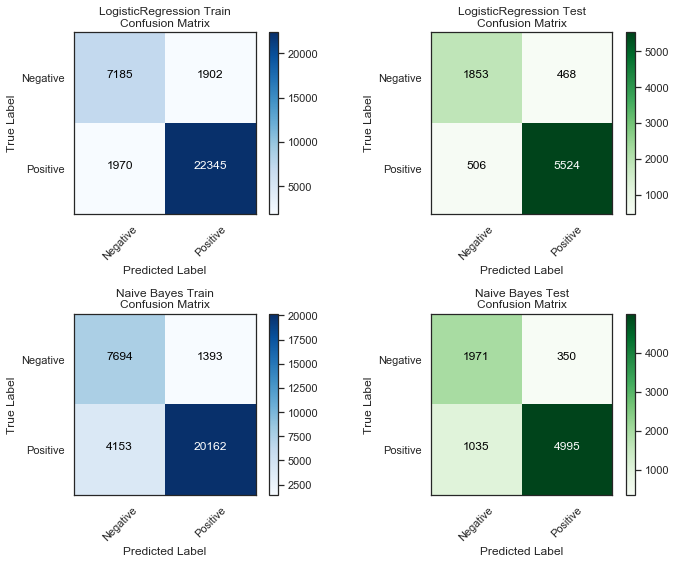

In [268]:
clf_tool.plot_confusion_matrix(classes=['Negative', 'Positive'])

## Final Implementation

In [269]:
# Defining a function to plot the sentiment of a given phrase
def sentiment_analysis(text, pipeline, vectorizer, model):
    """
    Args
    -----------
    text: text string / phrase / review comment to be analysed [type: string]
    pipeline: text prep pipeline built for preparing the corpus [type: sklearn.Pipeline]
    model: classification model trained to recognize positive and negative sentiment [type: model]
    """
    
    # Applying the pipeline
    if type(text) is not list:
        text = [text]
    text_prep = pipeline.fit_transform(text)
    matrix = vectorizer.transform(text_prep)
    
    # Predicting sentiment
    pred = model.predict(matrix)
    proba = model.predict_proba(matrix)
    
    # Plotting the sentiment and its score
    fig, ax = plt.subplots(figsize=(5, 3))
    if pred[0] == 1:
        text = 'Positive'
        class_proba = 100 * round(proba[0][1], 2)
        color = 'seagreen'
    else:
        text = 'Negative'
        class_proba = 100 * round(proba[0][0], 2)
        color = 'crimson'
    ax.text(0.5, 0.5, text, fontsize=50, ha='center', color=color)
    ax.text(0.5, 0.20, str(class_proba) + '%', fontsize=14, ha='center')
    ax.axis('off')
    ax.set_title('Sentiment Analysis', fontsize=14)
    plt.show()

In [270]:
model = clf_tool.classifiers_info['LogisticRegression']['estimator']
prod_pipeline = Pipeline([
    ('regex', ApplyRegex(regex_transformers)),
    ('stopwords', StopWordsRemoval(stopwords.words('portuguese'))),
    ('stemming', StemmingProcess(RSLPStemmer()))
])
vectorizer = text_pipeline.named_steps['text_features'].vectorizer

Now let's try to write a phrase to feed our sentiment_analysis function. In production, we can adapt it to serve any application. So, let's simulate an online review that says something like Very bad product! I don't buy on this store anymore, the delivery was late and it cost so much money.

What's the sentiment of this given phrase?

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!


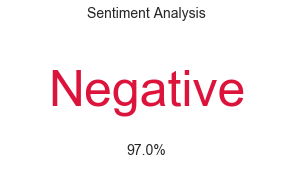

In [271]:
comment = 'Péssimo produto! Não compro nessa loja, a entrega atrasou e custou muito dinheiro!'
sentiment_analysis(comment, pipeline=prod_pipeline, vectorizer=vectorizer, model=model)

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!


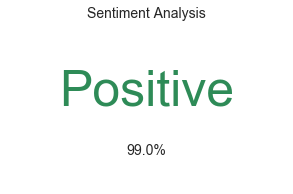

In [272]:
comment = 'Adorei e realmente cumpriu as expectativas. Comprei por um valor barato. Maravilhoso'
sentiment_analysis(comment, pipeline=prod_pipeline, vectorizer=vectorizer, model=model)

[nltk_data] Downloading package rslp to
[nltk_data]     C:\Users\DellPC\AppData\Roaming\nltk_data...
[nltk_data]   Package rslp is already up-to-date!


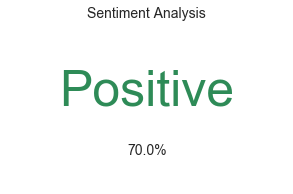

In [273]:
comment = 'Não sei gostei do produto. O custo foi barato mas veio com defeito. Se der sorte, vale a pena'
sentiment_analysis(comment, pipeline=prod_pipeline, vectorizer=vectorizer, model=model)

## Conclusion